# (03a) Extrinsic analysis

**Input files of this notebook:**
* `../config.yml`
* `../data/osm_{study_area}.graphml`
* `../data/osm_{study_area}_simple.graphml`
* `../data/ref_{study_area}.graphml`
* `../data/ref_{study_area}_simple.graphml`
* `../data/grid_{study_area}.gpkg`
* `../data/osm_nodes_{study_area}.pickle`
* `../data/osm_edges_{study_area}.pickle`
* `../data/osm_nodes_simplified_{study_area}.pickle`
* `../data/osm_edges_simplified_{study_area}.pickle`
* `../data/osm_nodes_joined{study_area}.pickle`
* `../data/osm_edges_joined{study_area}.pickle`
* `../data/osm_nodes_simplified_joined_{study_area}.pickle`
* `../data/osm_edges_simplified_joined_{study_area}.pickle`
* `../data/ref_nodes_{study_area}.pickle`
* `../data/ref_edges_{study_area}.pickle`
* `../data/ref_nodes_simplified_{study_area}.pickle`
* `../data/ref_edges_simplified_{study_area}.pickle`
* `../data/ref_nodes_joined_{study_area}.pickle`
* `../data/ref_edges_joined_{study_area}.pickle`
* `../data/ref_nodes_simplified_joined_{study_area}.pickle`
* `../data/ref_edges_simplified_joined_{study_area}.pickle`

**Output files of this notebook:**
* `../results/extrinsic_analysis_{study_area}.json`
* `../results/grid_results_extrinsic_{study_area}.pickle`
* `../results/plots/folium_multiple_edges_map_comparison.html`
* `../results/plots/folium_danglingmap_comparison.html`
* `../results/plots/folium_overundershoots_comparison.html`
* `../results/plots/folium_component_gaps_comparison`

**Overview**

This notebook contrasts and compares the OSM data on cycling infrastructure for a given area with a reference data set. To run this analysis, a reference data set must be available for comparison. 

The analysis is based on comparing OSM data to the reference dataset and highlighting how and where they differ, not only comparing *how much* cycling infrastructure is mapped in the two datasets, but also comparing *how* the infrastructure is mapped (e.g. looking at differing network topology and structure).

While the analysis is based on a comparison, we make no a priori assumptions about which dataset is better. The same goes for the identified differences: the workflow does not lead to an automatic conclusion as to which data set is of better quality, but instead requires the user to interpret the meaning of the differences found; e.g. whether differing features are results of errors of omission or comission, and which dataset is more correct.

The goal is that the identified differences can be used by the user to both assess the quality of the OSM and the reference datasets, and to support the decision of which dataset should be used for further analysis, if any.

**For a correct interpretation of some of the metrics for spatial data quality, some familiarity with the area is necessary.**

**Sections:**

1. Load and process data
2. Data completeness
    - Network length
    - Network densities
        - Global network density
        - Local network density
        - Density of protected vs. unprotected infrastructure
3. Network structure
    - Alpha, beta and gamma indices
    - Simplification outcomes
    - Number of nodes and edges per infrastructure length
    - Local edge to node ratio
4. Network topology
    - Dangling nodes
    - Under/overshoots
5. Network component analysis
    - Disconnected components
    - Component size distribution
    - Largest connected component
    - Edge number distribution
    - Number of components per grid cell
    - Component connectivity
6. Save Results

_________________________

## 1. Load and process data

In [134]:
import geopandas as gpd
import pandas as pd
import osmnx as ox
import yaml
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib import cm
import matplotlib as mpl
import contextily as cx
import json
import pickle
import folium
import numpy as np
from collections import Counter
from src import evaluation_functions as ef
from src import graph_functions as gf
from src import plotting_functions as pf


In [3]:
# read in dictionaries with plot settings
%run plotdict.py
%run tiledict.py

### Load settings

In [4]:
with open(r'../config.yml') as file:

    parsed_yaml_file = yaml.load(file, Loader=yaml.FullLoader)

    study_area = parsed_yaml_file['study_area']
    study_area_poly_fp = parsed_yaml_file['study_area_poly']
    study_crs = parsed_yaml_file['study_crs']

    missing_tag_dict = parsed_yaml_file['missing_tag_analysis']

    incompatible_tags_dict = parsed_yaml_file['incompatible_tags_analysis']

    cycling_infrastructure_queries = parsed_yaml_file['cycling_infrastructure_queries']

    reference_geometries = parsed_yaml_file['reference_geometries']
    cycling_bidirectional = parsed_yaml_file['bidirectional']
    
print('Settings loaded!')

Settings loaded!


### Load OSM and reference graphs and grid

In [5]:
# Load simplified and non-simplified graphs
osm_graph = ox.load_graphml(
    f'../data/osm_{study_area}.graphml', 
    edge_dtypes={'cycling_bidirectional': ox.io._convert_bool_string})

osm_simplified_graph = ox.load_graphml(
    f'../data/osm_{study_area}_simple.graphml', 
    edge_dtypes={'cycling_bidirectional': ox.io._convert_bool_string, 
    'infrastructure_length':float})

ref_graph = ox.load_graphml(f'../data/ref_{study_area}.graphml')
ref_simplified_graph = ox.load_graphml(
    f'../data/ref_{study_area}_simple.graphml',
    edge_dtypes={'infrastructure_length':float})

print('Graphs loaded!')

# Load grid
grid = gpd.read_file(f'../data/grid_{study_area}.gpkg')
grid_ids = grid.grid_id.to_list()

with open(f'../data/osm_nodes_{study_area}.pickle', 'rb') as fp:
    osm_nodes = pickle.load(fp)

with open(f'../data/osm_edges_{study_area}.pickle', 'rb') as fp:
    osm_edges = pickle.load(fp)

with open(f'../data/osm_nodes_simplified_{study_area}.pickle', 'rb') as fp:
    osm_nodes_simplified = pickle.load(fp)

with open(f'../data/osm_edges_simplified_{study_area}.pickle', 'rb') as fp:
    osm_edges_simplified = pickle.load(fp)

# Joined data
with open(f'../data/osm_nodes_joined_{study_area}.pickle', 'rb') as fp:
    osm_nodes_joined = pickle.load(fp)

with open(f'../data/osm_edges_joined_{study_area}.pickle', 'rb') as fp:
    osm_edges_joined = pickle.load(fp)

with open(f'../data/osm_nodes_simplified_joined_{study_area}.pickle', 'rb') as fp:
    osm_nodes_simp_joined = pickle.load(fp)

with open(f'../data/osm_edges_simplified_joined_{study_area}.pickle', 'rb') as fp:
    osm_edges_simp_joined = pickle.load(fp)

print('OSM data loaded!')

with open(f'../data/ref_nodes_{study_area}.pickle', 'rb') as fp:
    ref_nodes = pickle.load(fp)

with open(f'../data/ref_edges_{study_area}.pickle', 'rb') as fp:
    ref_edges = pickle.load(fp)

with open(f'../data/ref_nodes_simplified_{study_area}.pickle', 'rb') as fp:
    ref_nodes_simplified = pickle.load(fp)

with open(f'../data/ref_edges_simplified_{study_area}.pickle', 'rb') as fp:
    ref_edges_simplified = pickle.load(fp)

# Joined data
with open(f'../data/ref_nodes_joined_{study_area}.pickle', 'rb') as fp:
    ref_nodes_joined = pickle.load(fp)

with open(f'../data/ref_edges_joined_{study_area}.pickle', 'rb') as fp:
    ref_edges_joined = pickle.load(fp)

with open(f'../data/ref_nodes_simplified_joined_{study_area}.pickle', 'rb') as fp:
    ref_nodes_simp_joined = pickle.load(fp)

with open(f'../data/ref_edges_simplified_joined_{study_area}.pickle', 'rb') as fp:
    ref_edges_simp_joined = pickle.load(fp)

print('Reference data loaded!')

# Dictionaries for saving data
all_results = {}
results_ref = {}
results_osm = {}

Graphs loaded!
OSM data loaded!
Reference data loaded!


### Plot data

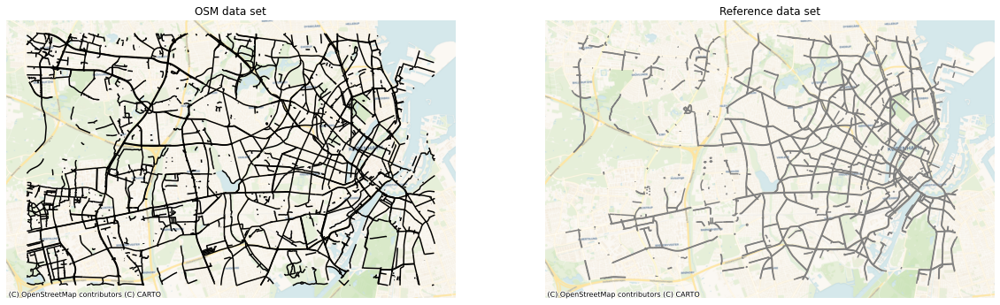

In [6]:
fig, ax = plt.subplots(1,2,figsize=(20,10))

# OSM
i = 0
osm_edges_simplified.plot(ax = ax[i], color = pdict["osm_base"])
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('OSM data set')
ax[i].set_axis_off()

# REF
i = 1
ref_edges_simplified.plot(ax = ax[i], color = pdict["ref_base"])
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Reference data set')
ax[i].set_axis_off()

_________________

## 2. Data completeness

This section compares the OSM and reference datasets in terms of completeness.  

### Why?

The goal is to identify whether one dataset has more cycling infrastructure mapped than the other, and if so, whether those differences are concentrated in some areas. In the section below, first the total length of the infrastructure is compared for both data sets. Then, node and edge densities (i.e. the number of nodes/edges per square kilometer) compared both at global (study area) and at local (grid cell) level. Finally, density differences for protected and unprotected bicycle infrastructure are compared separately.

### How?

To account for differences in how cycling infrastructure has been mapped, the computation of network length and density is based on the infrastructure length, not the geometric length of the network edges. For example, a 100 meter long **bi**directional path (geometric length: 100m) contributes with 200 meters of cycling infrastructure (infrastructure length: 200m).

### What could it mean?

Density differences can point to incomplete data. For instance, if a grid cell has a significantly higher edge density in the OSM than in the reference data set, this indicates unmapped grid cell features in the reference data set. 


**Subsections:**

- Network length
- Network densities
    - Global network density
    - Local network density
    - Density of protected vs. unprotected infrastructure

### Network length

In [7]:
ref_length = ref_edges_simplified.infrastructure_length.sum()
osm_length = osm_edges_simplified.infrastructure_length.sum()

h = max([ref_length, osm_length])
l = min([ref_length, osm_length])

diff = h - l

percent_diff = (osm_length - ref_length) / osm_length * 100

basel = diff / l * 100 # High is x percent higher than l
baseh = diff / h * 100 # Low is x percent lower than h

if ref_length > osm_length:
    hlab = "reference"
    llab = "OSM"
elif osm_length > ref_length:
    hlab = "OSM"
    llab = "reference"

print(f'Length of the OSM data set: {osm_length/1000:.2f} km')
print(f'Length of the reference data set: {ref_length/1000:.2f} km')
print("\n")
print(f'The {hlab} data set is {diff/1000:.2f} km longer than the {llab} data set.')
print(f'The {hlab} data set is {baseh:.2f}% longer than the {llab} data set.')

all_results['ref_infra_length_m'] = ref_length
all_results['osm_infra_length_m'] = osm_length
all_results['length_difference_osm_ref'] = diff
all_results['pct_length_difference'] = percent_diff

Length of the OSM data set: 1062.83 km
Length of the reference data set: 626.48 km


The OSM data set is 436.35 km longer than the reference data set.
The OSM data set is 41.06% longer than the reference data set.


### Network Densities

#### Global Network Density

In [8]:
### OSM
osm_edge_density, osm_node_density, osm_dangling_node_density = ef.compute_network_density(
    (osm_edges_simplified, osm_nodes_simplified),
    grid.unary_union.area, 
    return_dangling_nodes=True)

results_osm['edge_density_m_sqkm'] = osm_edge_density
results_osm['node_density_sqkm'] = osm_node_density
results_osm['dangling_node_density_sqkm'] = osm_dangling_node_density

print(f'For the entire study area, there are {osm_edge_density:.2f} meters of cycling infrastructure per square km in OSM')
print(f'For the entire study area, there are {osm_node_density:.2f} nodes in the cycling network per square km in OSM')
print(f'For the entire study area, there are {osm_dangling_node_density:.2f} dangling nodes in the cycling network per square km in OSM')

For the entire study area, there are 5859.51 meters of cycling infrastructure per square km in OSM
For the entire study area, there are 26.81 nodes in the cycling network per square km in OSM
For the entire study area, there are 9.85 dangling nodes in the cycling network per square km in OSM


In [9]:
### REF
ref_edge_density, ref_node_density, ref_dangling_node_density = ef.compute_network_density(
    (ref_edges_simplified, ref_nodes_simplified),
    grid.unary_union.area, 
    return_dangling_nodes=True)
    
results_ref['edge_density_m_sqkm'] = ref_edge_density
results_ref['node_density_sqkm'] = ref_node_density
results_ref['dangling_node_density_sqkm'] = ref_dangling_node_density

print(f'For the entire study area, there are {ref_edge_density:.2f} meters of cycling infrastructure per square km in the reference data')
print(f'For the entire study area, there are {ref_node_density:.2f} nodes in the cycling network per square km in the reference data')
print(f'For the entire study area, there are {ref_dangling_node_density:.2f} dangling nodes in the cycling network per square km in the reference data')

For the entire study area, there are 3453.85 meters of cycling infrastructure per square km in the reference data
For the entire study area, there are 22.74 nodes in the cycling network per square km in the reference data
For the entire study area, there are 4.80 dangling nodes in the cycling network per square km in the reference data


##### Global differences in network density

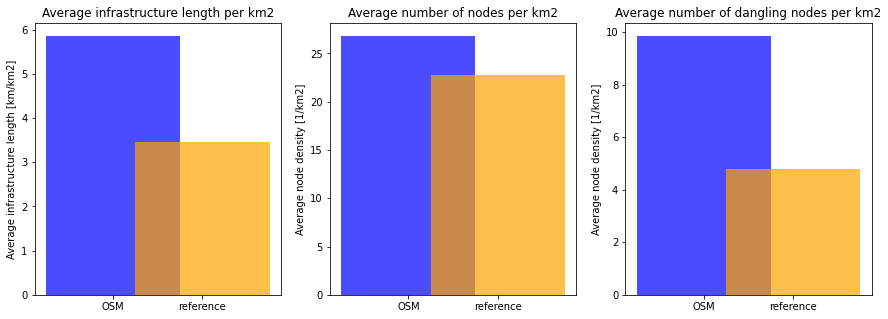

In [10]:
# PLOT GLOBAL DIFFERENCES 

fig, ax = plt.subplots(1,3,figsize=(15,5))
bars = ('OSM', 'reference')
y_pos = [0.5,1]

# Infrastructure length
i = 0
ax[i].bar(y_pos[0], [osm_edge_density/1000],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], color = pdict["osm"])
ax[i].bar(y_pos[1], [ref_edge_density/1000],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], color = pdict["ref"])
ax[i].set_title('Average infrastructure length per km2')
ax[i].set_xticks(y_pos, bars)
ax[i].set_ylabel("Average infrastructure length [km/km2]")

# Node density
i = 1
ax[i].bar(y_pos[0], [osm_node_density],  pdict["bar_double"], alpha = pdict["alpha_bar"], color = pdict["osm"])
ax[i].bar(y_pos[1], [ref_node_density],  pdict["bar_double"], alpha = pdict["alpha_bar"], color = pdict["ref"])
ax[i].set_title('Average number of nodes per km2')
ax[i].set_xticks(y_pos, bars)
ax[i].set_ylabel("Average node density [1/km2]")

# Dangling density
i = 2
ax[i].bar(y_pos[0], [osm_dangling_node_density],  pdict["bar_double"], alpha = pdict["alpha_bar"], color = pdict["osm"])
ax[i].bar(y_pos[1], [ref_dangling_node_density],  pdict["bar_double"], alpha = pdict["alpha_bar"], color = pdict["ref"])
ax[i].set_title('Average number of dangling nodes per km2')
ax[i].set_xticks(y_pos, bars)
ax[i].set_ylabel("Average node density [1/km2]");

#### Local Network Density

In [11]:
# OSM: Density per gridcell

results_dict = {}
data = (osm_edges_simp_joined, osm_nodes_simp_joined.set_index('osmid'))
[ef.run_grid_analysis(
    grid_id, 
    data, 
    results_dict, 
    ef.compute_network_density, 
    grid['geometry'].loc[grid.grid_id==grid_id].area.values[0], 
    return_dangling_nodes=True) 
for grid_id in grid_ids];

results_df = pd.DataFrame.from_dict(results_dict, orient='index')
results_df.reset_index(inplace=True)
results_df.rename(
    columns={
        'index':'grid_id', 
        0:'osm_edge_density',
        1:'osm_node_density'}, 
    inplace=True)

grid = ef.merge_results(grid,results_df,'left')

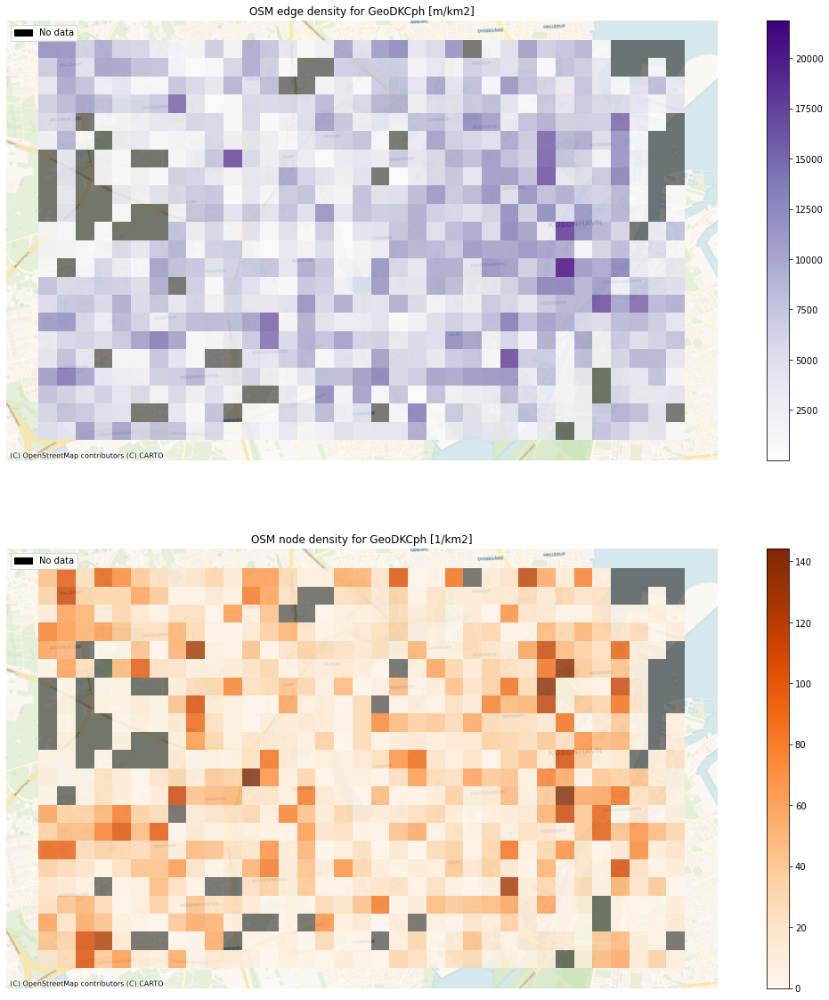

In [12]:
# Plot OSM data edge & node densities

fig, ax = plt.subplots(2,1,figsize=(20,20))

i = 0
grid.plot(ax = ax[i], column='osm_edge_density', legend=True, alpha = pdict["alpha_grid"], cmap = pdict["edgeden"])
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('OSM edge density for ' + study_area + " [m/km2]")
ax[i].set_axis_off()
# add black patches in grid cells with no data on edges
grid[grid["count_osm_edges"].isnull()].plot(ax = ax[i], color = pdict["nodata"], alpha = pdict["alpha_nodata"])
ax[i].legend(handles = [nodata_patch], loc = "upper left");


i = 1
grid.plot(ax = ax[i], column='osm_node_density', legend=True, alpha = pdict["alpha_grid"], cmap = pdict["nodeden"])
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('OSM node density for ' + study_area + " [1/km2]")
ax[i].set_axis_off()
# add black patches in grid cells with no data on nodes
grid[grid["count_osm_nodes"].isnull()].plot(ax = ax[i], color = pdict["nodata"], alpha = pdict["alpha_nodata"])
ax[i].legend(handles = [nodata_patch], loc = "upper left");


In [13]:
# REF: Density per gridcell

results_dict = {}
data = (ref_edges_simp_joined, ref_nodes_simp_joined.set_index('osmid'))

[ef.run_grid_analysis(
    grid_id, 
    data, 
    results_dict, 
    ef.compute_network_density, 
    grid['geometry'].loc[grid.grid_id==grid_id].area.values[0], 
    return_dangling_nodes=True) 
for grid_id in grid_ids];

results_df = pd.DataFrame.from_dict(results_dict, orient='index')
results_df.reset_index(inplace=True)
results_df.rename(
    columns = {
        'index':'grid_id', 
        0:'ref_edge_density',
        1:'ref_node_density'}, 
    inplace=True)

grid = ef.merge_results(grid,results_df,'left')

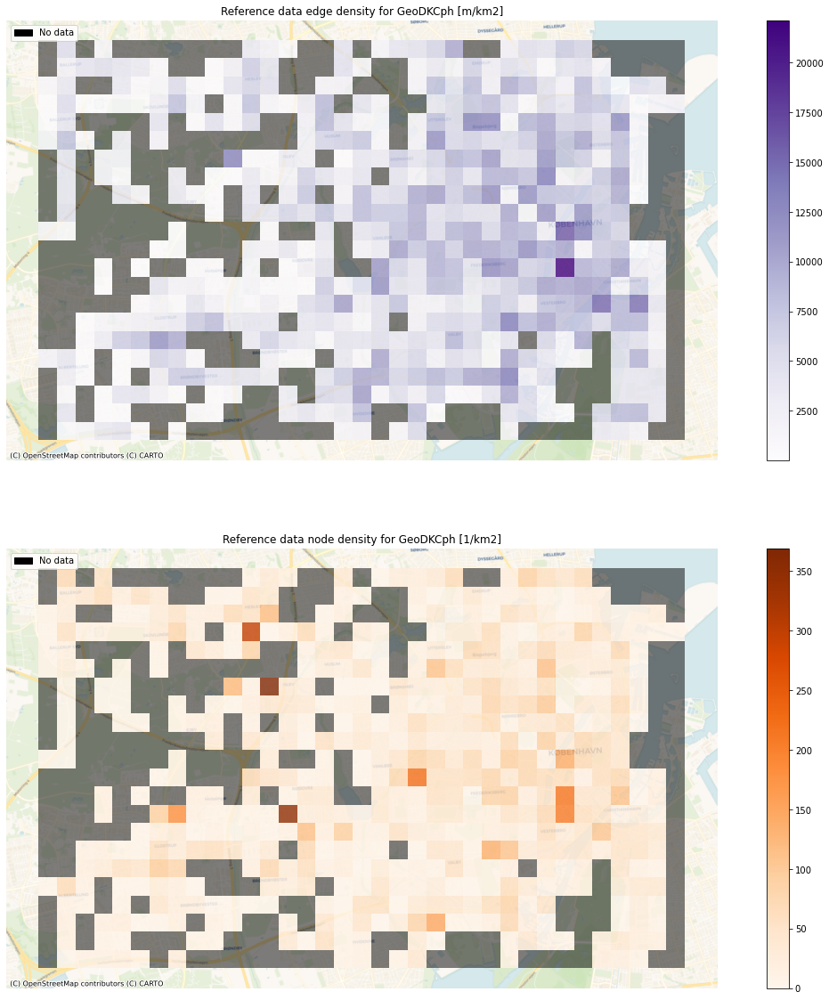

In [14]:
# Plot reference data edge & node densities

fig, ax = plt.subplots(2,1,figsize=(20,20))

i = 0
grid.plot(ax = ax[i], column='ref_edge_density', legend=True, alpha = pdict["alpha_grid"], cmap = pdict["edgeden"])
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Reference data edge density for ' + study_area + " [m/km2]")
ax[i].set_axis_off()
# add black patches in grid cells with no data on edges
grid[grid["count_ref_edges"].isnull()].plot(ax = ax[i], color = pdict["nodata"], alpha = pdict["alpha_nodata"])
ax[i].legend(handles = [nodata_patch], loc = "upper left");

i = 1
grid.plot(ax = ax[i], column='ref_node_density', legend=True, alpha = pdict["alpha_grid"], cmap = pdict["nodeden"])
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Reference data node density for ' + study_area + " [1/km2]")
ax[i].set_axis_off()
# add black patches in grid cells with no data on nodes
grid[grid["count_ref_nodes"].isnull()].plot(ax = ax[i], color = pdict["nodata"], alpha = pdict["alpha_nodata"])
ax[i].legend(handles = [nodata_patch], loc = "upper left");

##### Local differences in network density

The densities in the OSM data set are taken as base line for comparison. Hence, positive values indicate that the OSM density of the infrastructure type is higher than the reference density; negative values indicate that the OSM density is lower than the reference density.

In [15]:
grid['edge_density_diff'] = grid.osm_edge_density - grid.ref_edge_density
grid['node_density_diff'] = grid.osm_node_density - grid.ref_node_density

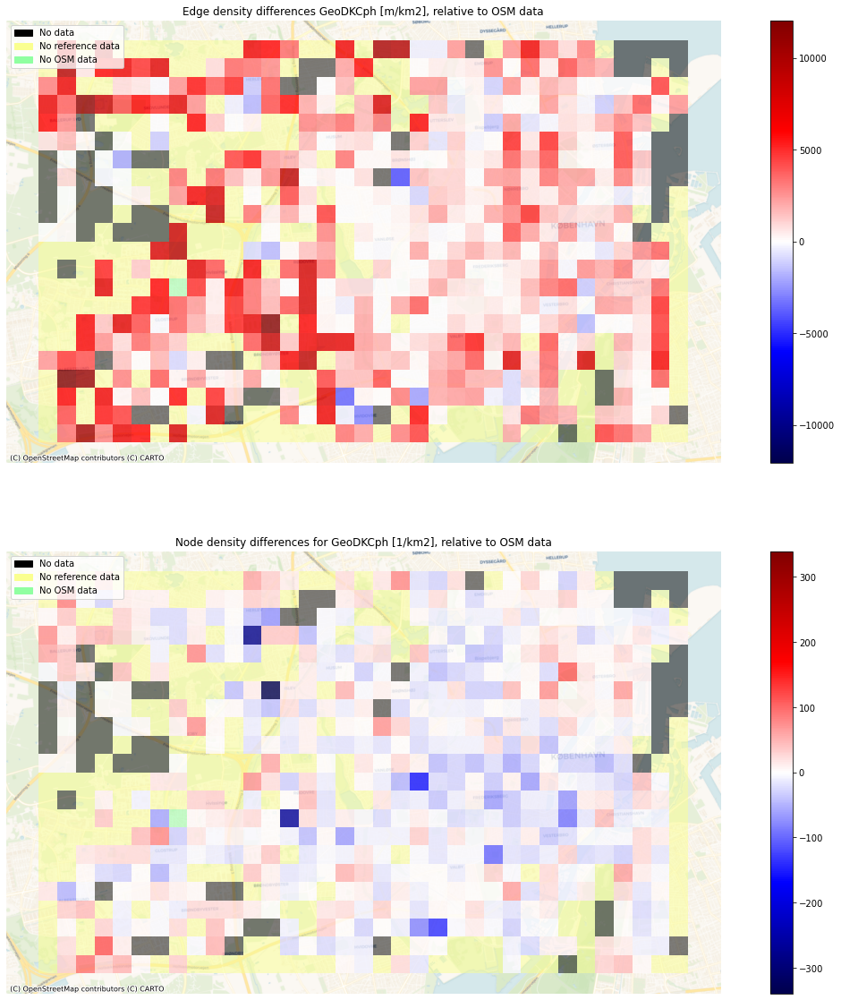

In [16]:
# PLOT DIFFERENCES

# norm color bars (centered around 0)
cblim_edge = max(abs(min(grid["edge_density_diff"].fillna(value=0))), max(grid["edge_density_diff"].fillna(value=0)))
cbnorm_edge = colors.Normalize(vmin=-cblim_edge, vmax=cblim_edge)

cblim_node = max(abs(min(grid["node_density_diff"].fillna(value=0))), max(grid["node_density_diff"].fillna(value=0)))
cbnorm_node = colors.Normalize(vmin=-cblim_node, vmax=cblim_node)

# set up figure
fig, ax = plt.subplots(2,1,figsize=(20,20))

# edge density:
i = 0
grid.plot(
    ax = ax[i], 
    column='edge_density_diff', 
    legend=True, 
    alpha = pdict["alpha_grid"], 
    cmap = pdict["diff"], 
    norm = cbnorm_edge)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Edge density differences ' + study_area + " [m/km2], relative to OSM data")
ax[i].set_axis_off()
# add patches in grid cells where none of the data sets has edges
grid[grid["osm_edge_density"].isnull() & grid["ref_edge_density"].isnull()].plot(
    ax = ax[i], color = pdict["nodata"], alpha = pdict["alpha_nodata"])
# add patches in gridcells where only OSM data has edges (ref has NO data)
grid[grid["osm_edge_density"].notnull() & grid["ref_edge_density"].isnull()].plot(
    ax = ax[i], color = pdict["nodata_ref"], alpha = pdict["alpha_nodata"])
# add patches in gridcells where only ref data has edges (osm has NO data)
grid[grid["osm_edge_density"].isnull() & grid["ref_edge_density"].notnull()].plot(
    ax = ax[i], color = pdict["nodata_osm"], alpha = pdict["alpha_nodata"])
ax[i].legend(handles = [nodata_patch, nodata_ref_patch, nodata_osm_patch], loc = "upper left");

# node density:
i = 1
grid.plot(
    ax = ax[i], 
    column='node_density_diff', 
    legend=True, 
    alpha = pdict["alpha_grid"], 
    cmap = pdict["diff"], 
    norm = cbnorm_node)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Node density differences for ' + study_area + " [1/km2], relative to OSM data")
ax[i].set_axis_off()
# add patches in grid cells where none of the data sets has nodes
grid[grid["osm_node_density"].isnull() & grid["ref_node_density"].isnull()].plot(
    ax = ax[i], color = pdict["nodata"], alpha = pdict["alpha_nodata"])
# add patches in gridcells where only OSM data has edges (ref has NO data)
grid[grid["osm_node_density"].notnull() & grid["ref_node_density"].isnull()].plot(
    ax = ax[i], color = pdict["nodata_ref"], alpha = pdict["alpha_nodata"])
# add patches in gridcells where only ref data has edges (osm has NO data)
grid[grid["osm_node_density"].isnull() & grid["ref_node_density"].notnull()].plot(
    ax = ax[i], color = pdict["nodata_osm"], alpha = pdict["alpha_nodata"])
ax[i].legend(handles = [nodata_patch, nodata_ref_patch, nodata_osm_patch], loc = "upper left");

#### Differences in density between protected/unprotected cycling infrastructure

##### Global Network Density for Protected/Unprocected Infrastructure

In [17]:
osm_protected = osm_edges_simp_joined.loc[osm_edges_simp_joined.protected=='protected']
osm_unprotected = osm_edges_simp_joined.loc[osm_edges_simp_joined.protected=='unprotected']
osm_mixed = osm_edges_simp_joined.loc[osm_edges_simp_joined.protected=='mixed']

ref_protected = ref_edges_simp_joined.loc[ref_edges_simp_joined.protected=='protected']
ref_unprotected = ref_edges_simp_joined.loc[ref_edges_simp_joined.protected=='unprotected']
ref_mixed = ref_edges_simp_joined.loc[ref_edges_simp_joined.protected=='mixed']

osm_data = [osm_protected, osm_unprotected, osm_mixed]
ref_data = [ref_protected, ref_unprotected, ref_mixed]

labels = ['protected_density', 'unprotected_density', 'mixed_density']

for data, label in zip(osm_data, labels):
    if len(data) > 0:
        osm_edge_density_type, _ = ef.compute_network_density((data, osm_nodes_simplified),grid.unary_union.area, return_dangling_nodes=False)
        results_osm[label+'_m_sqkm'] = osm_edge_density_type
    else:
        results_osm[label+'_m_sqkm'] = 0
    
    ed = results_osm[label+'_m_sqkm'] 

    print(f'Density for {label}: {ed:.2f} m/km2 in OSM data')

print("\n")

for data, label in zip(ref_data, labels):
    if len(data) > 0:
        ref_edge_density_type, _ = ef.compute_network_density((data, ref_nodes_simplified),grid.unary_union.area, return_dangling_nodes=False)
        results_ref[label+'_m_sqkm'] = ref_edge_density_type
    else:
        results_ref[label+'_m_sqkm'] = 0
    
    ed = results_ref[label+'_m_sqkm']
    print(f'Density for {label}: {ed:.2f} m/km2 in reference data')

Density for protected_density: 5298.37 m/km2 in OSM data
Density for unprotected_density: 507.13 m/km2 in OSM data
Density for mixed_density: 53.83 m/km2 in OSM data


Density for protected_density: 2998.80 m/km2 in reference data
Density for unprotected_density: 455.05 m/km2 in reference data
Density for mixed_density: 0.00 m/km2 in reference data


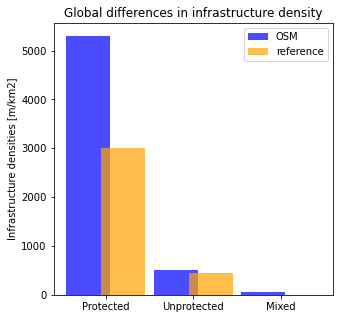

In [18]:
# PLOT GLOBAL DIFFERENCES 

fig, ax = plt.subplots(1,1,figsize=(5,5))
bars = ('OSM', 'reference')
y_pos = [0.5,1]

X = ['Protected', 'Unprotected', 'Mixed']
Yosm = [results_osm[label+'_m_sqkm'] for label in labels]
Zref = [results_ref[label+'_m_sqkm'] for label in labels]
  
X_axis = np.arange(len(X))
  
ax.bar(X_axis - 0.2, Yosm, label = 'OSM', width = pdict["bar_single"], alpha = pdict["alpha_bar"], color = pdict["osm"])
ax.bar(X_axis + 0.2, Zref, label = 'reference', width = pdict["bar_single"], alpha = pdict["alpha_bar"], color = pdict["ref"])
ax.set_xticks(X_axis, X)
ax.set_title("Global differences in infrastructure density")
ax.set_ylabel("Infrastructure densities [m/km2]")
ax.legend();

##### Local network density for protected/unprocected infrastructure

In [19]:
osm_labels = ['osm_protected_density', 'osm_unprotected_density','osm_mixed_density']
ref_labels = ['ref_protected_density', 'ref_unprotected_density','ref_mixed_density']

for data, label in zip(osm_data, osm_labels):
    if len(data) > 0:
        results_dict = {}
        data = (osm_edges_simp_joined.loc[data.index], osm_nodes_simp_joined)
        [ef.run_grid_analysis(
            grid_id, data, 
            results_dict, 
            ef.compute_network_density, 
            grid['geometry'].loc[grid.grid_id==grid_id].area.values[0]) 
        for grid_id in grid_ids];

        results_df = pd.DataFrame.from_dict(results_dict, orient='index')
        results_df.reset_index(inplace=True)
        results_df.rename(columns={'index':'grid_id', 0:label}, inplace=True)
        results_df.drop(1,axis=1,inplace=True)

        grid = ef.merge_results(grid,results_df,'left')

for data, label in zip(ref_data, ref_labels):
    if len(data) > 0:
        results_dict = {}
        data = (osm_edges_simp_joined.loc[data.index], osm_nodes_simp_joined)
        [ef.run_grid_analysis(
            grid_id, 
            data, 
            results_dict, 
            ef.compute_network_density, 
            grid['geometry'].loc[grid.grid_id==grid_id].area.values[0]) 
        for grid_id in grid_ids];

        results_df = pd.DataFrame.from_dict(results_dict, orient='index')
        results_df.reset_index(inplace=True)
        results_df.rename(columns={'index':'grid_id', 0:label}, inplace=True)
        results_df.drop(1,axis=1,inplace=True)

        grid = ef.merge_results(grid,results_df,'left')

# In case no infrastructure with mixed protected/unprotected exist
if 'osm_mixed_density' not in grid.columns:
    print('No streets mapped as mixed protected/unprotected in OSM data')
    grid['osm_mixed_density'] = 0

if 'ref_mixed_density' not in grid.columns:
    print('No streets mapped as mixed protected/unprotected in reference data')
    grid['ref_mixed_density'] = 0

grid['protected_density_diff'] = grid.osm_protected_density - grid.ref_protected_density
grid['unprotected_density_diff'] = grid.osm_unprotected_density - grid.ref_unprotected_density
grid['mixed_density_diff'] = grid.osm_mixed_density - grid.ref_mixed_density

No streets mapped as mixed protected/unprotected in reference data


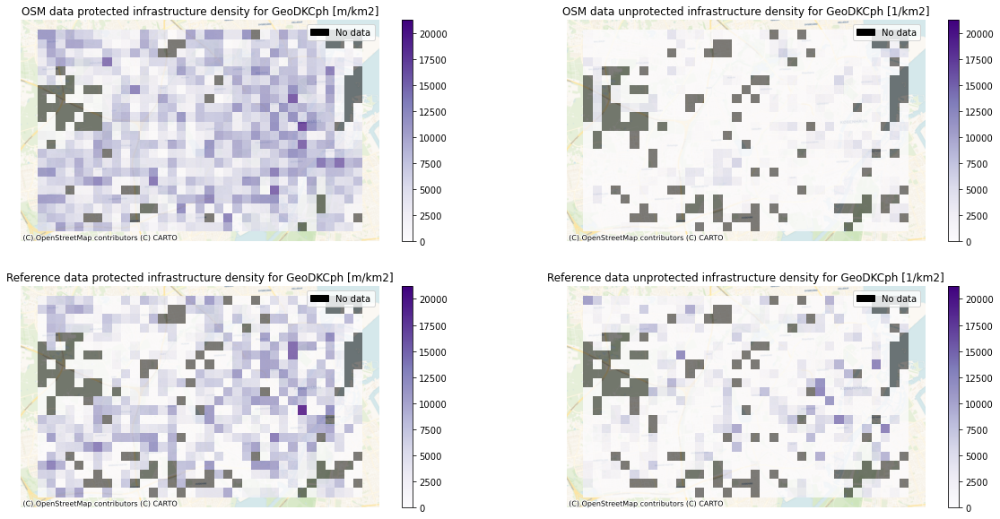

In [20]:
# Plot local densities

# norm all densities in the same way
ld_labels = ["osm_protected_density", "osm_unprotected_density", "ref_protected_density", "ref_unprotected_density"]
ld_lim = max(grid[ld_labels].fillna(value=0).max())
cbnorm_ld = colors.Normalize(vmin=0, vmax=ld_lim)

# set up figure
fig, ax = plt.subplots(2,2,figsize=(20,10))

i = (0,0)
grid.plot(
    ax = ax[i], 
    column='osm_protected_density', 
    legend=True, 
    alpha = pdict["alpha_grid"], 
    cmap = pdict["edgeden"], 
    norm = cbnorm_ld)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('OSM data protected infrastructure density for ' + study_area + " [m/km2]")
ax[i].set_axis_off()
# add patches in grid cells with no data
grid[grid["osm_protected_density"].isnull()].plot(
    ax = ax[i], alpha = pdict["alpha_nodata"], color = pdict["nodata"])
ax[i].legend(handles = [nodata_patch]);

i = (0,1)
grid.plot(
    ax = ax[i], 
    column='osm_unprotected_density', 
    legend=True, 
    alpha = pdict["alpha_grid"], 
    cmap = pdict["edgeden"], 
    norm = cbnorm_ld)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('OSM data unprotected infrastructure density for ' + study_area + " [1/km2]")
ax[i].set_axis_off()
# add patches in grid cells with no data
grid[grid["osm_unprotected_density"].isnull()].plot(
    ax = ax[i], alpha = pdict["alpha_nodata"], color = pdict["nodata"])
ax[i].legend(handles = [nodata_patch]);

i = (1,0)
grid.plot(
    ax = ax[i], 
    column='ref_protected_density', 
    legend=True, 
    alpha = pdict["alpha_grid"], 
    cmap = pdict["edgeden"], 
    norm = cbnorm_ld)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Reference data protected infrastructure density for ' + study_area + " [m/km2]")
ax[i].set_axis_off()
# add patches in grid cells with no data
grid[grid["ref_protected_density"].isnull()].plot(
    ax = ax[i], alpha = pdict["alpha_nodata"], color = pdict["nodata"])
ax[i].legend(handles = [nodata_patch]);

i = (1,1)
grid.plot(
    ax = ax[i], 
    column='ref_unprotected_density', 
    legend=True, 
    alpha = pdict["alpha_grid"], 
    cmap = pdict["edgeden"], norm = cbnorm_ld)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Reference data unprotected infrastructure density for ' + study_area + " [1/km2]")
ax[i].set_axis_off()
# add patches in grid cells with no data
grid[grid["ref_unprotected_density"].isnull()].plot(
    ax = ax[i], alpha = pdict["alpha_nodata"], color = pdict["nodata"])
ax[i].legend(handles = [nodata_patch]);

#### Local differences in network density for protected vs. unprotected infrastructure

The densities in the OSM data set are taken as base line for comparison. Hence, positive values indicate that the OSM density of the infrastructure type is higher than the reference density; negative values indicate that the OSM density is lower than the reference density.

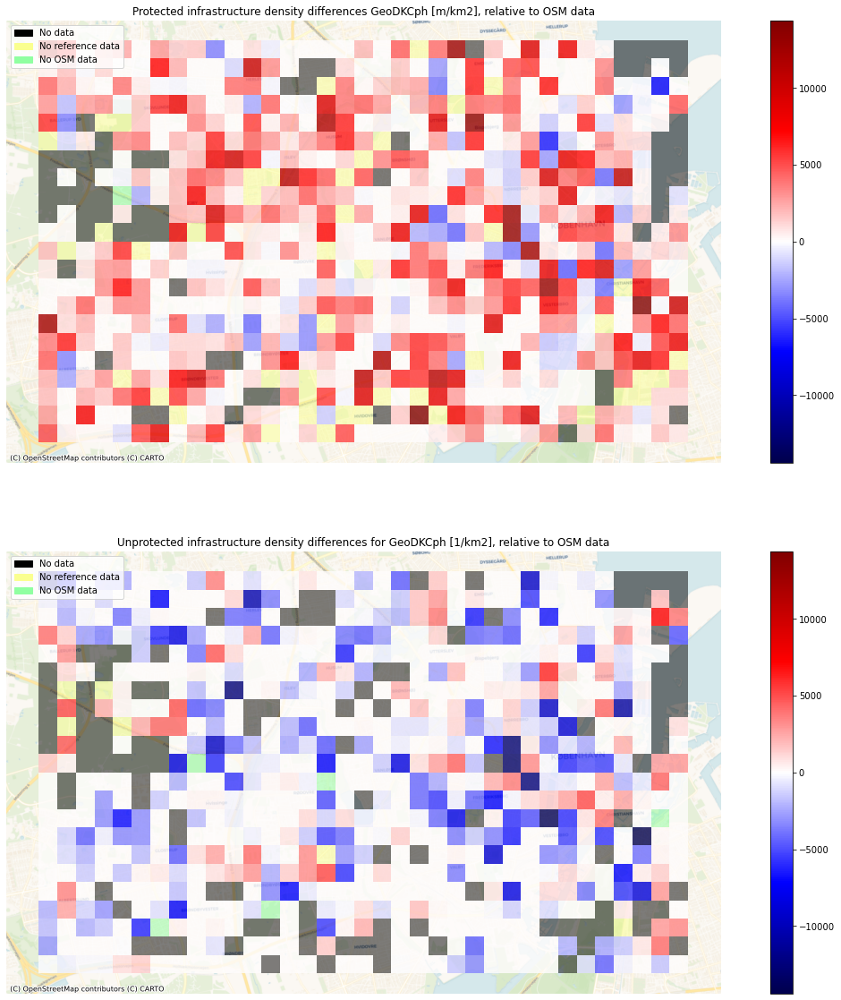

In [21]:
pud_labels = ["protected_density_diff", "unprotected_density_diff"]
# Create symmetrical color range around zero
cblim_pud = max(abs(min(grid[pud_labels].fillna(value=0).min())), max(grid[pud_labels].fillna(value=0).max()))
cbnorm_pud = colors.Normalize(vmin=-cblim_pud, vmax=cblim_pud)

# set up figure
fig, ax = plt.subplots(2,1,figsize=(20,20))

# Protected density:
i = 0
grid.plot(
    ax = ax[i], 
    column = 'protected_density_diff', 
    legend = True, 
    alpha = pdict["alpha_grid"], 
    cmap = pdict["diff"], 
    norm = cbnorm_pud)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Protected infrastructure density differences ' + study_area + " [m/km2], relative to OSM data")
ax[i].set_axis_off()
# add patches in grid cells where none of the data sets has protected edges
grid[grid["osm_protected_density"].isnull() & grid["ref_protected_density"].isnull()].plot(
    ax = ax[i], color = pdict["nodata"], alpha = pdict["alpha_nodata"])
# add patches in gridcells where only OSM data has protected edges (ref has NO data)
grid[grid["osm_protected_density"].notnull() & grid["ref_protected_density"].isnull()].plot(
    ax = ax[i], color = pdict["nodata_ref"], alpha = pdict["alpha_nodata"])
# add patches in gridcells where only ref data has protected edges (osm has NO data)
grid[grid["osm_protected_density"].isnull() & grid["ref_protected_density"].notnull()].plot(
    ax = ax[i], color = pdict["nodata_osm"], alpha = pdict["alpha_nodata"])
ax[i].legend(handles = [nodata_patch, nodata_ref_patch, nodata_osm_patch], loc = "upper left");


# Unprotected density:
i = 1
grid.plot(
    ax = ax[i], 
    column='unprotected_density_diff', 
    legend=True, 
    alpha = pdict["alpha_grid"], 
    cmap = pdict["diff"], 
    norm = cbnorm_pud)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Unprotected infrastructure density differences for ' + study_area + " [1/km2], relative to OSM data")
ax[i].set_axis_off()
# add patches in grid cells where none of the data sets has unprotected edges
grid[grid["osm_unprotected_density"].isnull() & grid["ref_unprotected_density"].isnull()].plot(
    ax = ax[i], color = pdict["nodata"], alpha = pdict["alpha_nodata"])
# add patches in gridcells where only OSM data has unprotected edges (ref has NO data)
grid[grid["osm_unprotected_density"].notnull() & grid["ref_unprotected_density"].isnull()].plot(
    ax = ax[i], color = pdict["nodata_ref"], alpha = pdict["alpha_nodata"])
# add patches in gridcells where only ref data has unprotected edges (osm has NO data)
grid[grid["osm_unprotected_density"].isnull() & grid["ref_unprotected_density"].notnull()].plot(
    ax = ax[i], color = pdict["nodata_osm"], alpha = pdict["alpha_nodata"])
ax[i].legend(handles = [nodata_patch, nodata_ref_patch, nodata_osm_patch], loc = "upper left");


___________________

## 3. Network structure

After having compared data completeness, i.e. *how much* infrastructure is mapped, in the section above, we now will focus on differences in network *structure*, which can give some information about *how* the infrastructure is mapped in both data sets. 

**Subsections:**

- Alpha, beta and gamma indices
- Simplification outcomes
- Number of nodes and edges per infrastructure length
- Local node/edge ratio

In each of the subsections, we compute the corresponding metrics for both data sets and then contrast the outcomes to visualize differences.

### Alpha, beta and gamma indices

In this subsection, we compute and contrast the three aggregated network metrics alpha, beta and gamma.

#### Why?

While no conclusion can be made about data quality based on any of the three metrics by itself, a comparison of the metrics for the two data sets can indicate differences in network topology, and hence differences in infrastructure mapping.

#### How?

All three indices are computed with `ef.compute_alpha_beta_gamma`.

The **alpha** value is the ratio of actual to possible cycles in the network. 

The **beta** value is the ratio of edges to nodes in the network. 

The **gamma** value is the ratio of actual to possible edges in the network.

For all three indices, see [Ducruet and Rodrigue, 2020](https://transportgeography.org/contents/methods/graph-theory-measures-indices/). All three indices can be interpreted in respect to network connectivity: The higher the alpha value, the more cycles are present in the network; the higher the beta value, the higher the number of paths and thus the higher the complexity of the network; and the higher the gamma value, the fewer edges lie between any pair of nodes.

#### What could it mean?

These metrics do not say much about the data quality itself, nor are they useful for a topological comparison of networks of similar size. However, some conclusions can be made through a comparison. For example, if the indices are very similiar for the two networks, despite the networks e.g. having very different geometric lengths, this suggests that the data sets have been mapped in roughly the same way, but than one simply includes more features than the other. On the other hand, if the networks have roughly the same total geometric length, but the values from alpha, beta and gamma differ, this can be an indication that the structure and topology of the two datasets are fundamentally different.

In [22]:
osm_alpha, osm_beta, osm_gamma = ef.compute_alpha_beta_gamma(edges=osm_edges_simplified, nodes=osm_nodes_simplified, G= osm_simplified_graph, planar=True) # We assume network to be planar or approximately planar

print(f'Alpha for the simplified OSM network is: {osm_alpha:.2f}')
print(f'Beta for the simplified OSM network is: {osm_beta:.2f}')
print(f'Gamma for the simplified OSM network is: {osm_gamma:.2f}')

ref_alpha, ref_beta, ref_gamma = ef.compute_alpha_beta_gamma(ref_edges_simplified, ref_nodes_simplified, ref_simplified_graph, planar=True) # We assume network to be planar or approximately planar

print(f'Alpha for the simplified reference network is: {ref_alpha:.2f}')
print(f'Beta for the simplified reference network is: {ref_beta:.2f}')
print(f'Gamma for the simplified reference network is: {ref_gamma:.2f}')

results_osm['alpha'] = osm_alpha
results_osm['beta'] = osm_beta
results_osm['gamma'] = osm_gamma

results_ref['alpha'] = ref_alpha
results_ref['beta'] = ref_beta
results_ref['gamma'] = ref_gamma

Alpha for the simplified OSM network is: 0.11
Beta for the simplified OSM network is: 1.15
Gamma for the simplified OSM network is: 0.39
Alpha for the simplified reference network is: 0.10
Beta for the simplified reference network is: 1.14
Gamma for the simplified reference network is: 0.38


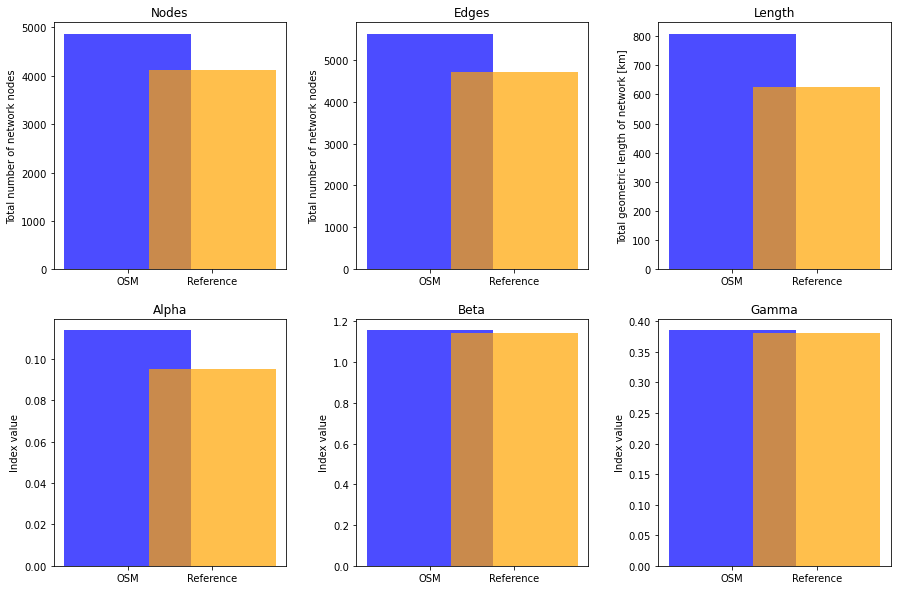

In [23]:
fig, ax = plt.subplots(2,3,figsize=(15,10))
fig.subplots_adjust(wspace = 0.3)

# Subplot 1: Total nodes 
i = (0,0)
y_pos = [0.5, 1]
#y_pos = [0.25, 1.25]
X = ['OSM', 'Reference']
X_axis = np.arange(len(X))

ax[i].bar(y_pos[0], [len(osm_nodes_simplified)],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "OSM", color = pdict["osm"])
ax[i].bar(y_pos[1], [len(ref_nodes_simplified)],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "reference", color = pdict["ref"])
ax[i].set_xticks(y_pos, X)
ax[i].set_ylabel("Total number of network nodes")
ax[i].set_title('Nodes')


# Subplot 2: Total edges 
i = (0,1)
y_pos = [0.5, 1]
X = ['OSM', 'Reference']
X_axis = np.arange(len(X))

ax[i].bar(y_pos[0], [len(osm_edges_simplified)],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "OSM", color = pdict["osm"])
ax[i].bar(y_pos[1], [len(ref_edges_simplified)],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "reference", color = pdict["ref"])
ax[i].set_xticks(y_pos, X)
ax[i].set_ylabel("Total number of network nodes")
ax[i].set_title('Edges')

# Subplot 3: Total geometric length
i = (0,2)

geolength_osm = osm_edges_simplified.length.sum()/1000
geolength_ref = ref_edges_simplified.length.sum()/1000

y_pos = [0.5, 1]
ax[i].bar(y_pos[0], [geolength_osm],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "OSM", color = pdict["osm"])
ax[i].bar(y_pos[1], [geolength_ref],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "reference", color = pdict["ref"])
ax[i].set_title('Length')
ax[i].set_xticks(y_pos, X)
ax[i].set_ylabel("Total geometric length of network [km]")

# Subplot 4: Alpha

i = (1,0)

y_pos = [0.5, 1]
X = ['OSM', 'Reference']
X_axis = np.arange(len(X))

ax[i].set_title('Alpha')
ax[i].set_ylabel("Index value");
ax[i].bar(y_pos[0], [osm_alpha],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "OSM", color = pdict["osm"])
ax[i].bar(y_pos[1], [ref_alpha],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "reference", color = pdict["ref"])
ax[i].set_xticks(y_pos, X)


# Subplot 5: Beta
i = (1,1)

y_pos = [0.5, 1]
X = ['OSM', 'Reference']
X_axis = np.arange(len(X))

ax[i].set_title('Beta')
ax[i].set_ylabel("Index value");
ax[i].bar(y_pos[0], [osm_beta],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "OSM", color = pdict["osm"])
ax[i].bar(y_pos[1], [ref_beta],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "reference", color = pdict["ref"])
ax[i].set_xticks(y_pos, X)

# Subplot 6: Gamma
i = (1,2)

y_pos = [0.5, 1]
X = ['OSM', 'Reference']
X_axis = np.arange(len(X))

ax[i].set_title('Gamma')
ax[i].set_ylabel("Index value");
ax[i].bar(y_pos[0], [osm_gamma],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "OSM", color = pdict["osm"])
ax[i].bar(y_pos[1], [ref_gamma],  width = pdict["bar_double"], alpha = pdict["alpha_bar"], label = "reference", color = pdict["ref"])
ax[i].set_xticks(y_pos, X);

### Simplification & graph conversion outcomes

When converting a set of geocoded linestrings (polygonal chains) to graph format, not all vertices (nodes) are of equal meaning. For geometry of the infrastructural element, all nodes are needed as an ordered list. For the topology of the network, however, only those nodes that are endpoints or intersection points with other edges are needed, while all other (so-called 'interstitial') nodes do not add any information. In order to compare the structure and true ratio between nodes and edges in a network, a simplified network representation which only includes nodes at endpoints and intersections, or where the value of important attributes changes, is required. Therefore, in the notebook `01_load_data` we already 'simplified' the cycling network by removing all interstitial nodes from the graph object (retaining, however, the complete node lists in the geometry attribute of each edge). An additional advantage of simplifying the network is the resulting substantial reduction of the number of nodes and edges, which makes computational routines much faster.

#### Why?

Comparing the node degree distribution for the networks before and after simplification is a quick sanity check for the simplification routine. Typically, the big majority of nodes in the non-simplified network will be of degree two; in the simplified network, however, most nodes will have degrees other than two. Degree two nodes are retained in only two cases: if they represent a connection point between two different types of infrastructure; or if they are needed in order to avoid self-loops (edges whose start and end points are identical) or multiple edges between the same pair of nodes. 

As part of the simplification routine, in cases where there are several edges between the same pair of nodes ('parallel edges' or 'multiedges'), only one of the edges is retained. Within the routine, we count how many edges are removed in this way. 

#### How?

Below, we print out both the node degree distributions before and after simplification, and the information on parallel edges removed by the simplificaton routine, for the OSM and reference data sets. In the map, the OSM and reference networks are shown in black and grey, respectively, while OSM and reference multiedges are shown in red and orange, respectively.

#### What could it mean?

Typically, the node degree distribution will go from high (before simplification) to low (after simplification) counts of degree two nodes, while it will not change for all other degrees (1, or 3 and higher). Further, the total number of nodes will see a strong decline. If the simplified graph still maintains a relatively high number of degree two nodes, or if the number of nodes with other degrees changes after the simplification, this might point to issues either with the graph conversion or with the simplification process.

Comparing the node degree distributions before/after simplification for both data sets can indicate differences in feature mapping. For example, let us suppose that the OSM data set has a much higher pronounced peak at d=2 in the node degree distribution than the reference data set. This can mean that the edges in the reference data set were already represented by polygonal chains rather than by two-point linestrings. 

The instances where parallel edges between the same pair of nodes were removed are a potential data quality issue of 'overmapping', where one infrastructure element is represented by several identical or nearly identical features. Alternatively, if many parallel edges are present in the data set, this could point to a problem in the conversion from linestrings to graph format, for example in how nodes are defined. 

In terms of comparison between the reference and OSM data set, a higher number of parallel edges can point to lower quality of the data.



In [24]:
osm_edge_percent_diff = (len(osm_edges) - len(osm_edges_simplified)) / len(osm_edges)*100
osm_node_percent_diff = (len(osm_nodes) - len(osm_nodes_simplified)) / len(osm_nodes)*100

ref_edge_percent_diff = (len(ref_edges) - len(ref_edges_simplified)) / len(ref_edges)*100
ref_node_percent_diff = (len(ref_nodes) - len(ref_nodes_simplified)) / len(ref_nodes)*100

results_osm['simplified_edge_pct_diff'] = osm_edge_percent_diff
results_osm['simplified_node_pct_diff'] = osm_node_percent_diff

results_ref['simplified_edge_pct_diff'] = ref_edge_percent_diff
results_ref['simplified_node_pct_diff'] = ref_node_percent_diff

print(f'Simplifying the OSM network decreased the number of edges with {osm_edge_percent_diff:.1f}%')
print(f'Simplifying the OSM network decreased the number of nodes with {osm_node_percent_diff:.1f}%')
print("\n")
print(f'Simplifying the reference network decreased the number of edges with {ref_edge_percent_diff:.1f}%')
print(f'Simplifying the reference network decreased the number of nodes with {ref_node_percent_diff:.1f}%')

Simplifying the OSM network decreased the number of edges with 88.8%
Simplifying the OSM network decreased the number of nodes with 84.3%


Simplifying the reference network decreased the number of edges with 91.2%
Simplifying the reference network decreased the number of nodes with 92.2%


OSM node degree counts before simplification: Counter({2: 26571, 1: 1787, 3: 1781, 4: 710, 5: 27, 7: 1, 6: 1})
OSM node degree counts after simplification: Counter({1: 1787, 3: 1781, 4: 710, 2: 556, 5: 27, 7: 1, 6: 1})


Reference node degree counts before simplification: Counter({2: 50705, 1: 870, 3: 827, 4: 591, 5: 7})
Reference node degree counts after simplification: Counter({2: 1830, 1: 870, 3: 827, 4: 591, 5: 7})


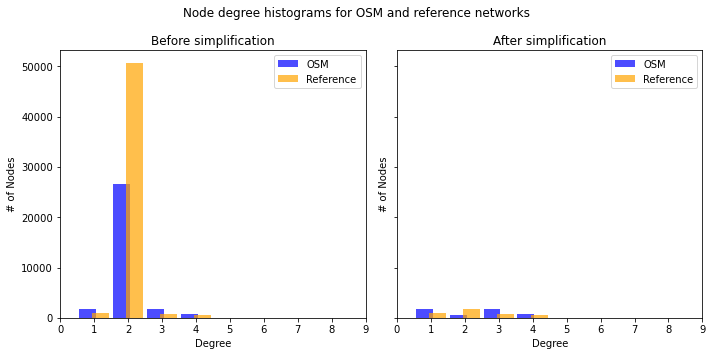

In [25]:
# Plot node degree distributions

degree_sequence_before_osm = sorted((d for n, d in osm_graph.degree()), reverse=True)
degree_sequence_after_osm = sorted((d for n, d in osm_simplified_graph.degree()), reverse=True)

degree_sequence_before_ref = sorted((d for n, d in ref_graph.degree()), reverse=True)
degree_sequence_after_ref = sorted((d for n, d in ref_simplified_graph.degree()), reverse=True)

print('OSM node degree counts before simplification:', Counter(degree_sequence_before_osm))
print('OSM node degree counts after simplification:', Counter(degree_sequence_after_osm))
print("\n")
print('Reference node degree counts before simplification:', Counter(degree_sequence_before_ref))
print('Reference node degree counts after simplification:', Counter(degree_sequence_after_ref))

fig, ax = plt.subplots(1, 2, figsize=(10, 5), sharex = True, sharey = True)

X = [i for i in range(10)]
X_axis = np.arange(len(X))  

i = 0
ax[i].bar(
    x = np.unique(degree_sequence_before_osm, return_counts = True)[0] - 0.2, 
    height = np.unique(degree_sequence_before_osm, return_counts = True)[1], 
    width = pdict["bar_single"], 
    label = 'OSM', 
    alpha = pdict["alpha_bar"],
    color = pdict["osm"])
ax[i].bar(
    x = np.unique(degree_sequence_before_ref, return_counts = True)[0] + 0.2, 
    height = np.unique(degree_sequence_before_ref, return_counts = True)[1], 
    width = pdict["bar_single"], 
    label = 'Reference', 
    alpha = pdict["alpha_bar"],
    color = pdict["ref"])
ax[i].set_xticks(X_axis, X)
ax[i].set_title('Before simplification')
ax[i].set_xlabel('Degree')
ax[i].set_ylabel('# of Nodes')
ax[i].legend()

i = 1
ax[i].bar(
    x = np.unique(degree_sequence_after_osm, return_counts = True)[0] - 0.2, 
    height = np.unique(degree_sequence_after_osm, return_counts = True)[1], 
    width = pdict["bar_single"], 
    label = 'OSM', 
    alpha = pdict["alpha_bar"],
    color = pdict["osm"])
ax[i].bar(
    x = np.unique(degree_sequence_after_ref, return_counts = True)[0] + 0.2, 
    height = np.unique(degree_sequence_after_ref, return_counts = True)[1], 
    width = pdict["bar_single"], 
    label = 'Reference', 
    alpha = pdict["alpha_bar"],
    color = pdict["ref"])
ax[i].set_xticks(X_axis, X)
ax[i].set_title('After simplification')
ax[i].set_xlabel('Degree')
ax[i].set_ylabel('# of Nodes')
ax[i].legend()

plt.suptitle('Node degree histograms for OSM and reference networks')
plt.tight_layout()

In [26]:
# Get df and dict of multiedges (removed by simplification routine)

# format: str to int
osm_edges_simplified['multiedge'] = osm_edges_simplified['multiedge'].astype(int)
ref_edges_simplified['multiedge'] = ref_edges_simplified['multiedge'].astype(int)

# get list of multiple edges
osm_multiple_edges = osm_edges_simplified[osm_edges_simplified['multiedge']>0].copy()
ref_multiple_edges = ref_edges_simplified[ref_edges_simplified['multiedge']>0].copy()

# save results to dict (for later json saving)
osm_multiple_edges_results = list(osm_multiple_edges.index)
ref_multiple_edges_results = list(ref_multiple_edges.index)

In [27]:
# Folium plot of multiple edges identified by simplification routine

if len(osm_multiple_edges_results) + len(ref_multiple_edges_results) > 0:

    myfgs = []

    osm_edges_simplified_folium = pf.make_edgefeaturegroup(
        gdf = osm_edges_simplified,
        mycolor = pdict["osm_base"],
        myweight = pdict["line_base"],
        nametag = 'OSM all edges',
        show_edges = True
    )

    myfgs.append(osm_edges_simplified_folium)

    ref_edges_simplified_folium = pf.make_edgefeaturegroup(
        gdf = ref_edges_simplified,
        mycolor = pdict["ref_base"],
        myweight = pdict["line_base"],
        nametag = 'Reference all edges',
        show_edges = True
    )

    myfgs.append(ref_edges_simplified_folium)

    if len(osm_multiple_edges_results) > 0:
        osm_multiple_edges_folium = pf.make_edgefeaturegroup(
            gdf = osm_multiple_edges,
            myweight = pdict["line_emp2"],
            mycolor = pdict["osm_emp"],
            nametag = 'OSM multiple edges',
            show_edges = True
        )
        myfgs.append(osm_multiple_edges_folium)
    else:
        print("No multiple edges in OSM data set")
    
    if len(ref_multiple_edges_results) > 0:
        ref_multiple_edges_folium = pf.make_edgefeaturegroup(
            gdf = ref_multiple_edges,
            myweight = pdict["line_emp2"],
            mycolor = pdict["ref_emp"],
            nametag = 'Reference multiple edges',
            show_edges = True
        )
        myfgs.append(ref_multiple_edges_folium)
    else:
        print("No multiple edges in reference data set")

    m = pf.make_foliumplot(
        feature_groups = myfgs,
        layers_dict = folium_layers,
        center_gdf = osm_nodes_simplified,
        center_crs = osm_nodes_simplified.crs
    )

    m.save('../results/plots/folium_multiple_edges_map_comparison.html')

    display(m)

else:
    print("No multiple edges found in OSM nor reference data set")

No multiple edges found in OSM nor reference data set


### Local average node degree

While the global edge to node ratio was already computed above as the beta index, the section below compares a local equivalent based on the average node degree *grid cell level* for the OSM and reference data sets. 
Node degree simply refers to how many edges are connected to a given node. In our case we work with undirected networks and do not distinguish between whether the node is a start or an end node for the edge.

#### Why?

Since the grid cells boundaries are artificially placed, and do not represent real network boundaries, computing the edge to node ratio on a grid cell level does not allow any judgement of the network structure. 
Using the average node degree for a local area can however indicate how well connected the network is locally.

#### How?

Below, we compute the average node degree for every grid cell with `ef.get_average_node_degree` and visualize the results for both data sets, as well as a comparison plot.

#### What could it mean?

The higher the average degree the more interconnected the nodes are; a very low average degree indicates the nodes predominantly are dangling nodes due to the network ending (dead-ends or end of study area) and/or gaps or missing links in the data.

In [28]:
# Compute node degrees
osm_ave_deg = ef.get_average_node_degree(osm_simplified_graph, osm_nodes_simp_joined,'osm')
ref_ave_deg = ef.get_average_node_degree(ref_simplified_graph, ref_nodes_simp_joined,'ref')

# Join to grid
grid = ef.merge_results(grid,osm_ave_deg,'left')
grid = ef.merge_results(grid,ref_ave_deg,'left')

grid['ave_degree_diff'] = grid.osm_ave_degree - grid.ref_ave_degree

In the calculation of differences in average degree, the OSM data set are taken as base line for comparison. Hence, positive values indicate that the OSM average node degree is higher than in the reference data set; negative values indicate that the OSM average node degree is lower than in the reference data set.

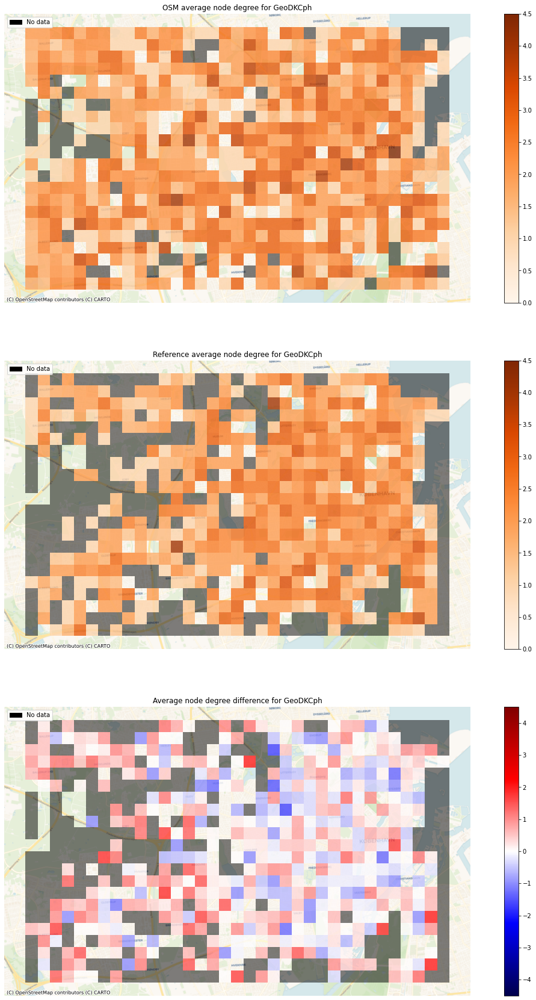

In [36]:
# PLOT DIFFERENCES

# norm color bars
cblim_and = max(max(grid['osm_ave_degree']), max(grid['ref_ave_degree']))
cbnorm_and = colors.Normalize(vmin=0, vmax=cblim_and) # from 0 to max
cbnorm_and_diff = colors.Normalize(vmin=-cblim_and, vmax=cblim_and) # from -max to +max

# set up figure
fig, ax = plt.subplots(3,1,figsize=(20,30))

# OSM data set:
i = 0
grid.plot(
    ax = ax[i], 
    column='osm_ave_degree', 
    legend=True, 
    alpha = pdict["alpha_grid"], 
    cmap = pdict["nodeden"], 
    norm = cbnorm_and)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('OSM average node degree for ' + study_area)
ax[i].set_axis_off()
# add patches in grid cells with no data
grid[grid["count_osm_nodes"].isnull()].plot(
    ax = ax[i], alpha = pdict["alpha_nodata"], color = pdict["nodata"])
ax[i].legend(handles = [nodata_patch], loc = "upper left");

# Reference data set:
i = 1
grid.plot(
    ax = ax[i], 
    column='ref_ave_degree', 
    legend=True, 
    alpha = pdict["alpha_grid"], 
    cmap = pdict["nodeden"], 
    norm = cbnorm_and)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Reference average node degree for ' + study_area)
ax[i].set_axis_off()
# add patches in grid cells with no data
grid[grid["count_ref_nodes"].isnull()].plot(
    ax = ax[i], alpha = pdict["alpha_nodata"], color = pdict["nodata"])
ax[i].legend(handles = [nodata_patch], loc = "upper left");

# Comparison:
i = 2
grid.plot(
    ax = ax[i], 
    column='ave_degree_diff', 
    legend=True, 
    alpha = pdict["alpha_grid"], 
    cmap = pdict["diff"], 
    norm = cbnorm_and_diff)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Average node degree difference for ' + study_area)
ax[i].set_axis_off()
# add patches in grid cells with no data
grid[(grid["count_osm_nodes"].isnull()) | (grid["count_ref_nodes"].isnull())].plot(
    ax = ax[i], alpha = pdict["alpha_nodata"], color = pdict["nodata"]);
ax[i].legend(handles = [nodata_patch], loc = "upper left");

____________________________

## 4. Network topology

In the following two subsections, dangling nodes and over- and undershoots are visualized and compared for both data sets.

**Subsections:**

- Dangling nodes
- Under/overshoots

### Dangling nodes

#### Why?

Dangling nodes are nodes of degree one - in other words, nodes that have only one single edge attached to them. Most networks will naturally contain a number of dangling nodes. Dangling nodes can occur at actual dead-ends (representing a cul-de-sac), at the endpoints of certain features (e.g. when a bicycle path ends in the middle of a street), or in case of over/undershoots (as described in detail in the next section). The number of dangling nodes in a network does to some extent also depend on the digitization method, as shown in the illustration below. 

Therefore, the presence of dangling nodes is in itself not a sign of low data quality. However, a high number of dangling nodes in an area that is not known for suffering from many dead-ends can indicate digitization errors and problems with edge over/undershoots.

<img src='../images/dangling_nodes_illustration.png' height=200 />  <img src='../images/no_dangling_nodes_illustration.png' height=200 />

*Dangling nodes occur where road features end (left), but when separate features are joined at the end (right), there will be no dangling nodes*

#### How?

Below, we obtain a list of all dangling nodes with the help of `get_dangling_nodes`. Then, for both data sets, we plot the network with all its nodes. For OSM, the dangling nodes are shown in red, all other nodes and the network itself are shown in black. For the reference data set, the dangling nodes are shown in orange, all other nodes and the network itself are shown in grey. 

#### What could it mean?

We recommend a visual analysis in order to interpret the spatial distribution of dangling nodes, with particular attention to areas of high dangling node density. It is important to understand where dangling nodes come from: are they actual dead-ends or digitization errors (e.g. over/undershoots)? A higher number of digitization errors points to a lower quality of the data.

#### Dangling nodes - global

In [38]:
# Compute number of dangling nodes
osm_dangling_nodes = ef.get_dangling_nodes(osm_edges_simplified, osm_nodes_simplified)
ref_dangling_nodes = ef.get_dangling_nodes(ref_edges_simplified, ref_nodes_simplified)

# Save dangling nodes count to dict
results_osm['dangling_node_count'] = len(osm_dangling_nodes)
results_ref['dangling_node_count'] = len(ref_dangling_nodes)

In [39]:
# Folium plot of dangling nodes

osm_edges_simplified_folium = pf.make_edgefeaturegroup(
    gdf = osm_edges_simplified,
    mycolor = pdict["osm_base"],
    myweight = pdict["line_base"],
    nametag = 'OSM edges',
    show_edges = True
)

osm_nodes_simplified_folium = pf.make_nodefeaturegroup(
    gdf = osm_nodes_simplified,
    mysize = pdict["mark_base"],
    mycolor = pdict["osm_base"],
    nametag = 'OSM all nodes',
    show_nodes = True
)

osm_dangling_nodes_folium = pf.make_nodefeaturegroup(
    gdf = osm_dangling_nodes,
    mysize = pdict["mark_emp"],
    mycolor = pdict["osm_emp"],
    nametag = 'OSM dangling nodes',
    show_nodes = True
)

ref_edges_simplified_folium = pf.make_edgefeaturegroup(
    gdf = ref_edges_simplified,
    mycolor = pdict["ref_base"],
    myweight = pdict["line_base"],
    nametag = 'Reference edges',
    show_edges = True
)

ref_nodes_simplified_folium = pf.make_nodefeaturegroup(
    gdf = ref_nodes_simplified,
    mysize = pdict["mark_base"],
    mycolor = pdict["ref_base"],
    nametag = 'Reference all nodes',
    show_nodes = True
)

ref_dangling_nodes_folium = pf.make_nodefeaturegroup(
    gdf = ref_dangling_nodes,
    mysize = pdict["mark_emp"],
    mycolor = pdict["ref_emp"],
    nametag = 'Reference dangling nodes',
    show_nodes = True
)

m = pf.make_foliumplot(
    feature_groups = [
        osm_edges_simplified_folium,
        osm_nodes_simplified_folium,
        osm_dangling_nodes_folium,        
        ref_edges_simplified_folium,
        ref_nodes_simplified_folium, 
        ref_dangling_nodes_folium],
    layers_dict = folium_layers,
    center_gdf = osm_nodes_simplified,
    center_crs = osm_nodes_simplified.crs
)

m.save('../results/plots/folium_danglingmap_comparison.html')

display(m)

#### Dangling nodes - local

In [40]:
dn_osm_joined = gpd.overlay(osm_dangling_nodes, grid[['geometry','grid_id']], how ='intersection')
df = ef.count_features_in_grid(dn_osm_joined,'osm_dangling_nodes')
grid = ef.merge_results(grid,df,'left')

dn_ref_joined = gpd.overlay(ref_dangling_nodes, grid[['geometry','grid_id']], how ='intersection')
df = ef.count_features_in_grid(dn_ref_joined,'ref_dangling_nodes')
grid = ef.merge_results(grid,df,'left')

# compute percentages of nodes that are dangling (per grid cell)
grid['osm_dangling_nodes_pct'] = np.round(100 * grid.count_osm_dangling_nodes / grid.count_osm_simplified_nodes, 2)
grid['ref_dangling_nodes_pct'] = np.round(100 * grid.count_ref_dangling_nodes / grid.count_ref_simplified_nodes, 2)
grid['dangling_nodes_diff_pct'] = np.round(100*(grid.count_osm_dangling_nodes - grid.count_ref_dangling_nodes)/grid.count_osm_dangling_nodes, 2)

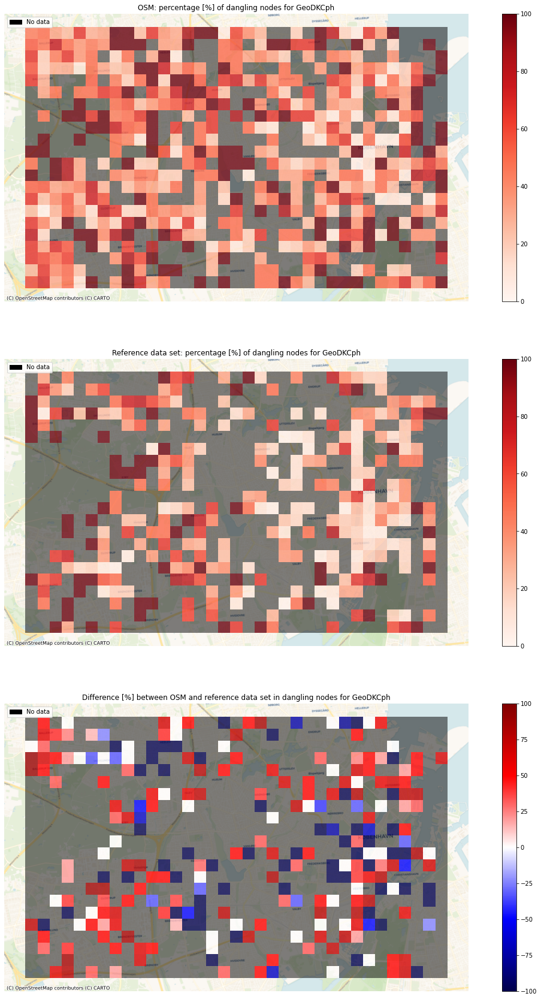

In [49]:
### PLOT

# norm color bars
cbnorm_dang = colors.Normalize(vmin=0, vmax=100) # from -max to +max
cbnorm_dang_diff = colors.Normalize(vmin=-100, vmax=100) # from -max to +max

# set up figure
fig, ax = plt.subplots(3,1,figsize=(20,30))

# OSM data set:
i = 0
grid.plot(ax = ax[i], column='osm_dangling_nodes_pct', legend=True, alpha = pdict["alpha_grid"], cmap = pdict["miss"], norm = cbnorm_dang)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('OSM: percentage [%] of dangling nodes for ' + study_area)
ax[i].set_axis_off()
# add patches in grid cells with no data
grid[grid["osm_dangling_nodes_pct"].isnull()].plot(
    ax = ax[i], alpha = pdict["alpha_nodata"], color = pdict["nodata"])
ax[i].legend(handles = [nodata_patch], loc = "upper left");

# Reference data set:
i = 1
grid.plot(ax = ax[i], column='ref_dangling_nodes_pct', legend=True, alpha = pdict["alpha_grid"], cmap = pdict["miss"], norm = cbnorm_dang)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Reference data set: percentage [%] of dangling nodes for ' + study_area)
ax[i].set_axis_off()
# add patches in grid cells with no data
grid[grid["ref_dangling_nodes_pct"].isnull()].plot(
    ax = ax[i], alpha = pdict["alpha_nodata"], color = pdict["nodata"])
ax[i].legend(handles = [nodata_patch], loc = "upper left");

# Comparison:
i = 2
grid.plot(ax = ax[i], column='dangling_nodes_diff_pct', legend=True, alpha = pdict["alpha_grid"], cmap = pdict["diff"], norm = cbnorm_dang_diff)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Difference [%] between OSM and reference data set in dangling nodes for ' + study_area)
ax[i].set_axis_off()
# add patches in grid cells with no data
grid[grid["dangling_nodes_diff_pct"].isnull()].plot(
    ax = ax[i], alpha = pdict["alpha_nodata"], color = pdict["nodata"])
ax[i].legend(handles = [nodata_patch], loc = "upper left");


### Under/overshoots 

#### Why?

When two nodes in a simplified network are placed within a distance of a few meters, but do not share a common edge, we often have a case of an edge over/undershoot or another digitizing error. An overshoot occurs when two features meet and one of them extends beyond the other. An undershoot occurs when two features are supposed to meet, but instead are just in close proximity to each other. See the image below for an illustration of an overshoot (left) and an undershoot (right). For a more detailed explanation of over/undershoots, see the [GIS Lounge website](https://www.gislounge.com/digitizing-errors-in-gis/).

<img src='../images/overshoot_illustration.png' height=200 />  <img src='../images/undershoot_illustration.png' height=200 />

*Overshoots refer to situations where a line feature extends too far beyond at intersecting line, rather than ending at the intersection (left).* 
*Undershoots happen when two line features are not properly joined, for example at intersection (right)*

#### How?

**Overshoots:** First, we define the `length_tolerance` (in meters). The default value is set to `length_tolerance = 3` and can be changed in the code snippet below. Then, with `find_overshoots`, we identify all network edges that have a dangling node attached to them and that have a maximum length of `length_tolerance`, as overshoots, and plot the results.

**Undershoots**: First, we define the `length_tolerance` (in meters). The default value is set to `length_tolerance = 3` and can be changed in the code snippet below. Then, with `find_undershoots`, we identify all pairs of dangling nodes that have a maximum of `length_tolerance` distance between them, as undershoots, and plot the results.

In the map plot, the network edges, overshoot edges, and undershoot nodes for the OSM data set are plotted in black, red and blue, respectively. The network edges, overshoot edges, and undershoot nodes for the reference data set are plotted in grey, orange and purple, respectively.

The workflow for over/undershoot detection below is based on [Barron et al., 2014](https://onlinelibrary.wiley.com/doi/10.1111/tgis.12073).

#### What could it mean?

Note that over/undershoots are not necessarily always a data quality issue - they might be instead an accurate representation of the network conditions or of the digitization strategy (for example, a cycle path might end abruptly soon after a turn, which results in an overshoot; protected cycle paths are often digitized in OSM as interrupted at intersections, which results in intersection 'undershoots') 

The interpretation of the impact of over/undershoots on data quality is context-dependent. For certain applications, such as routings, overshoots do not present a particular challenge; they can, however, pose an issue for other applications such as network analysis, given that they skew the network structure.  Undershoots, on the contrary, are a serious problem for routing applications, especially if only cycling infrastructure is considered; they also pose a problem for network analysis, for example for any path-based metric, such as most centrality measures (e.g. betweenness centrality).

If one of the two networks has a significantly higher number of over/undershoots than the other, this can be a sign of poorer data quality.

**// User configuration //**

In the analysis of over and undershoots, the user can modify the length tolerance for both over and undershoots.

In [51]:
### Compute over/undershoots

# Overshoots 

osm_overshoots = ef.find_overshoots(osm_dangling_nodes, osm_edges_simplified, 3)
ref_overshoots = ef.find_overshoots(ref_dangling_nodes, ref_edges_simplified, 3)

results_osm['count_overshoots'] = len(osm_overshoots)
results_ref['count_overshoots'] = len(ref_overshoots)

# Undershoots

osm_undershoot_dict, osm_undershoot_nodes = ef.find_undershoots(osm_dangling_nodes, osm_edges_simplified, 3,'edge_id')
ref_undershoot_dict, ref_undershoot_nodes = ef.find_undershoots(ref_dangling_nodes, ref_edges_simplified, 3,'edge_id')

results_osm['count_undershoots'] = len(osm_undershoot_nodes)
results_ref['count_undershoots'] = len(ref_undershoot_nodes)

In [52]:
### Folium plot over/undershoots

feature_groups = []

# OSM feature groups
osm_edges_simplified_folium = pf.make_edgefeaturegroup(
    gdf = osm_edges_simplified,
    mycolor = pdict["osm_base"],
    myweight = pdict["line_base"],
    nametag = 'OSM network',
    show_edges = True
)

feature_groups.append(osm_edges_simplified_folium)


if len(osm_overshoots) > 0:
    osm_overshoots_folium = pf.make_edgefeaturegroup(
        gdf = osm_overshoots,
        mycolor = pdict["osm_emp"],
        myweight = pdict["line_emp"],
        nametag = 'OSM overshoots',
        show_edges = True
    )

    feature_groups.append(osm_overshoots_folium)

if len(osm_undershoot_nodes) > 0:
    osm_undershoot_nodes_folium = pf.make_nodefeaturegroup(
        gdf = osm_undershoot_nodes,
        mysize = pdict["mark_emp"],
        mycolor = pdict["osm_emp2"],
        nametag = 'OSM undershoot nodes',
        show_nodes = True
    )

    feature_groups.append(osm_undershoot_nodes_folium)


# Reference feature groups
ref_edges_simplified_folium = pf.make_edgefeaturegroup(
    gdf = ref_edges_simplified,
    mycolor = pdict["ref_base"],
    myweight = pdict["line_base"],
    nametag = 'Reference network',
    show_edges = True
)

feature_groups.append(ref_edges_simplified_folium)

if len(ref_overshoots) > 0:
    ref_overshoots_folium = pf.make_edgefeaturegroup(
        gdf = ref_overshoots,
        mycolor = pdict["ref_emp"],
        myweight = pdict["line_emp"],
        nametag = 'Reference overshoots',
        show_edges = True
    )
    
    feature_groups.append(ref_overshoots_folium)

if len(ref_undershoot_nodes) > 0:
    
    ref_undershoot_nodes_folium = pf.make_nodefeaturegroup(
        gdf = ref_undershoot_nodes,
        mysize = pdict["mark_emp"],
        mycolor = pdict["ref_emp2"],
        nametag = 'Reference undershoot nodes',
        show_nodes = True
    )
    
    feature_groups.append(ref_undershoot_nodes_folium)

m = pf.make_foliumplot(
    feature_groups = feature_groups,
    layers_dict = folium_layers,
    center_gdf = osm_nodes_simplified,
    center_crs = osm_nodes_simplified.crs
)

m.save('../results/plots/folium_overundershoots_comparison.html')

display(m)

__________________

## 5. Network component analysis

This section takes a close look at the network component characteristics for each of the two data sets.

**Subsections:**

- Disconnected components
- Component size distribution
- Largest connected component
- Edge number distribution
- Grid cells with no components
- Grid cells with more than one component
- Component connectivity

### Disconnected components

#### Why?

Disconnected components do not share any elements (nodes/edges). In other words, there is no network path that could lead from one disconnected component to the other. As mentioned above, most real-world networks of cycling infrastructure do consist of many disconnected components ([Natera Orozco et al., 2020](https://onlinelibrary.wiley.com/doi/pdfdirect/10.1111/gean.12324)). However,  when two disconnected components are very close to each other, it might be a sign of a missing edge or another digitizing error.

#### How?

First, with the help of `return_components`, we obtain a list of all (disconnected) components of the network. We print out the total number of components, and create a plot of all components in different colours for a visual analysis. We then look at the component size distribution (by node number) and the distribution of total edge lengths (i.e. network length per component). Next, we identify the largest connected component and plot it. Finally, with `find_adjacent_components`, we identify all components with less than `buffer_dist` meters between them. 

#### What could it mean?

Given that the data represents the actual infrastructure accurately, bigger components indicate coherent network parts, while smaller components indicate scattered infrastructure (e.g. one single bicycle path along a street that does not connect to any other bicycle infrastructure). A high number of disconnected components in near vicinity of each other could indicate digitization errors or missing data.

Likewise, when comparing the OSM and reference data set, a higher number of disconnected components might mean that this data set is either more patchy (with some of the infrastructure missing from the map) or more detailed (with smaller gaps in the infrastructure mapped out in more detail). 

Therefore, as with many of the previous analysis steps, knowledge of the area is crucial for a correct interpretation of component analysis. 

**// User configuration //**

In the analysis of potential missing links between components (components which only have for example a 10 meter gap between them), the user can define the threshold for when the distance between two components are considered to be low enough that a digitization error is suspected.

**Number of disconnected components:**

In [53]:
osm_components = ef.return_components(osm_simplified_graph)
print(f'The OSM network in the study area consists of {len(osm_components)} unconnected components.')

ref_components = ef.return_components(ref_simplified_graph)
print(f'The reference network in the study area consists of {len(ref_components)} unconnected components.')

The OSM network in the study area consists of 353 unconnected components.
The reference network in the study area consists of 204 unconnected components.


**Plot OSM and reference components:**

Text(0.5, 1.0, 'Reference components')

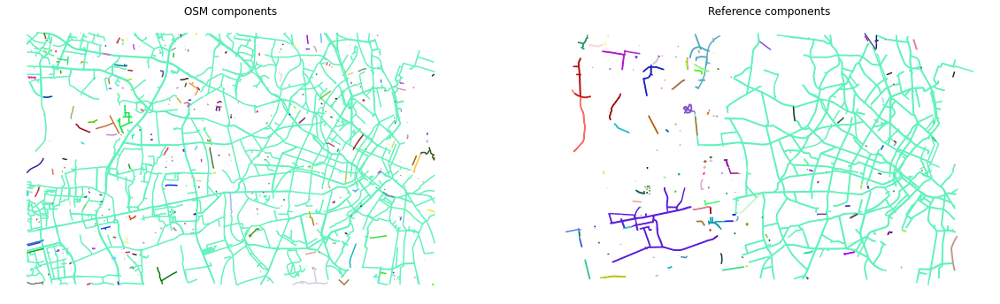

In [73]:
# set seed for colors
np.random.seed(42)

# generate enough random colors to plot all components
randcols = np.random.rand(max(len(osm_components), len(ref_components)), 3)

fig, ax = plt.subplots(1, 2, figsize = (20,10))

# plot osm components
i = 0
for j, c in enumerate(osm_components):
    if len(c.edges) > 0:
        edges = ox.graph_to_gdfs(c, nodes = False)
        edges.plot(ax = ax[i], color = randcols[j])
ax[i].set_axis_off()
ax[i].set_title("OSM components");

# plot ref components
i = 1
for j, c in enumerate(ref_components):
    if len(c.edges) > 0:
        edges = ox.graph_to_gdfs(c, nodes = False)
        edges.plot(ax = ax[i], color = randcols[j])
ax[i].set_axis_off()
ax[i].set_title("Reference components");

**Distribution of network length per component:**

In [74]:
# Compute network length distribution

osm_components_length = {}

for i, c in enumerate(osm_components):

    c_length = 0

    for (u, v, l) in c.edges(data='length'):

        c_length += l
        
    osm_components_length[i] = c_length

osm_components_df = pd.DataFrame.from_dict(osm_components_length, orient='index')

osm_components_df.rename(columns={0:'component_length'}, inplace=True)


ref_components_length = {}

for i, c in enumerate(ref_components):

    c_length = 0

    for (u, v, l) in c.edges(data='length'):

        c_length += l
        
    ref_components_length[i] = c_length

ref_components_df = pd.DataFrame.from_dict(ref_components_length, orient='index')

ref_components_df.rename(columns={0:'component_length'}, inplace=True)

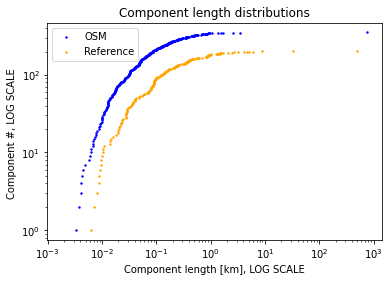

In [76]:
# Plot results

plt.scatter(
    x = sorted(list(osm_components_df['component_length']/1000)),
    y = [i for i in range(len(osm_components_df))], 
    s = pdict["mark_emp"],
    label = "OSM",
    color = pdict["osm"]
)

plt.scatter(
    x = sorted(list(ref_components_df['component_length']/1000)),
    y = [i for i in range(len(ref_components_df))], 
    s = pdict["mark_emp"],
    label = "Reference",
    color = pdict["ref"]
)

plt.xscale('log')
plt.yscale('log')
plt.xlabel('Component length [km], LOG SCALE')
plt.ylabel('Component #, LOG SCALE ')
plt.title("Component length distributions")
plt.legend();

**Largest connected component:**

In [77]:
# Compute length of largest component

osm_largest_cc = max(osm_components, key=len)

osm_largest_cc_length = 0

for (u, v, l) in osm_largest_cc.edges(data='length'):

        osm_largest_cc_length += l

osm_largest_cc_pct = osm_largest_cc_length / osm_components_df['component_length'].sum() * 100

print(f'The largest connected component in the OSM network contains {osm_largest_cc_pct:.2f} % of the network length.')

ref_largest_cc = max(ref_components, key=len)

ref_largest_cc_length = 0

for (u, v, l) in ref_largest_cc.edges(data='length'):

        ref_largest_cc_length += l

ref_largest_cc_pct = ref_largest_cc_length / ref_components_df['component_length'].sum() * 100

print(f'The largest connected component in the reference network contains {ref_largest_cc_pct:.2f} % of the network length.')

The largest connected component in the OSM network contains 92.37 % of the network length.
The largest connected component in the reference network contains 80.04 % of the network length.


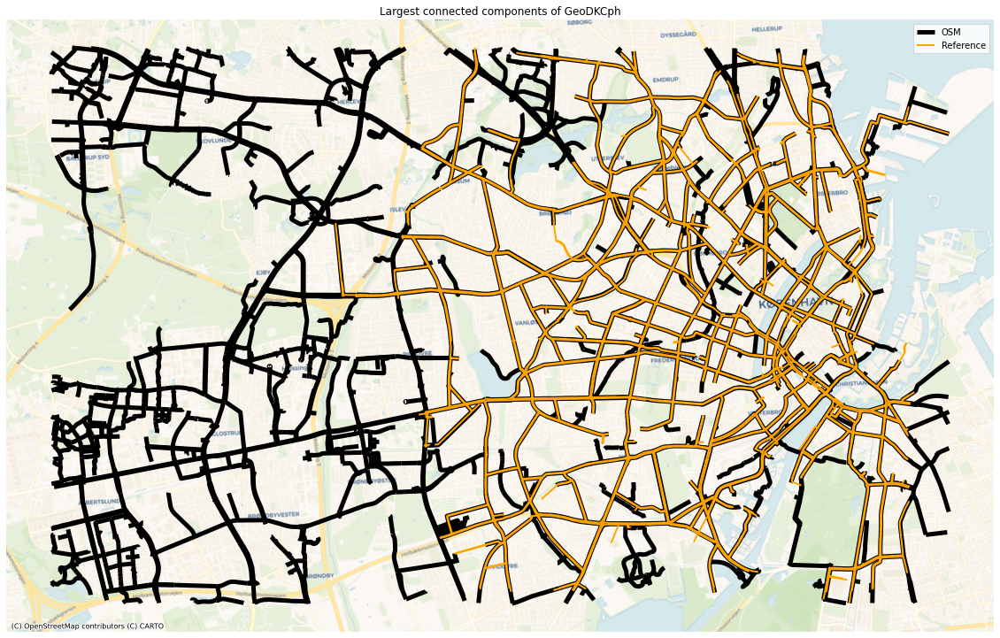

In [79]:
# Plot the largest connected components

osm_lcc_edges = ox.graph_to_gdfs(
    G = osm_largest_cc, 
    nodes = False, 
    edges = True, 
    node_geometry = False, 
    fill_edge_geometry = False)

ref_lcc_edges = ox.graph_to_gdfs(
    G = ref_largest_cc, 
    nodes = False, 
    edges = True, 
    node_geometry = False, 
    fill_edge_geometry = False)

fig, ax = plt.subplots(1, 1, figsize = (20,20))

osm_lcc_edges.plot(ax = ax, linewidth = 5, color = pdict["osm_base"], label = "OSM")
ref_lcc_edges.plot(ax = ax, linewidth = 2, color = pdict["ref_emp"], label = "Reference")
ax.set_axis_off()
ax.set_title(f'Largest connected components of {study_area}')
ax.legend()

cx.add_basemap(ax = ax, crs=study_crs, source=cx.providers.CartoDB.Voyager)

**Identifying potential missing links between unconnected components:**

In the map, the OSM and reference networks are shown in black and grey, respectively, while edges with potential missing links between ("component gaps") for OSM and the reference data set are shown in red and orange, respectively.

In [80]:
# Compute component gaps

osm_comp_gaps, osm_comp_edges = ef.find_adjacent_components(
    components=osm_components, 
    buffer_dist=10, 
    edge_id='edge_id', 
    crs=study_crs,
    return_edges = True)
    
ref_comp_gaps, ref_comp_edges = ef.find_adjacent_components(
    components=ref_components, 
    buffer_dist=10, 
    edge_id='edge_id', 
    crs=study_crs,
    return_edges = True)

In [81]:
# Folium plot of adjacent components

# The map highlights edges in different components with less than the specified threshold length between them

feature_groups = []

# Feature groups for OSM
osm_edges_simplified_folium = pf.make_edgefeaturegroup(
    gdf = osm_edges_simplified,
    mycolor = pdict["osm_base"],
    myweight = pdict["line_base"],
    nametag = 'OSM network',
    show_edges = True
)

feature_groups.append(osm_edges_simplified_folium)

if len(osm_comp_gaps) > 0:

    osm_component_gaps_folium = pf.make_edgefeaturegroup(
        gdf = osm_comp_gaps,
        mycolor = pdict["osm_emp"],
        myweight = pdict["line_emp"],
        nametag = 'OSM component issues',
        show_edges = True
    )

    feature_groups.append(osm_component_gaps_folium)

# Feature group for reference

ref_edges_simplified_folium = pf.make_edgefeaturegroup(
    gdf = ref_edges_simplified,
    mycolor = pdict["ref_base"],
    myweight = pdict["line_base"],
    nametag = 'Reference network',
    show_edges = True
)

feature_groups.append(ref_edges_simplified_folium)

if len(ref_comp_gaps) > 0:
    ref_component_gaps_folium = pf.make_edgefeaturegroup(
        gdf = ref_comp_gaps,
        mycolor = pdict["ref_emp"],
        myweight = pdict["line_emp"],
        nametag = 'Reference component issues',
        show_edges = True
    )

    feature_groups.append(ref_component_gaps_folium)

m = pf.make_foliumplot(
    feature_groups = feature_groups,
    layers_dict = folium_layers,
    center_gdf = osm_nodes_simplified,
    center_crs = osm_nodes_simplified.crs
)

m.save('../results/plots/folium_component_gaps_comparison.html')

display(m)

Assign component id to grid:

In [82]:
grid = ef.assign_component_id_to_grid(osm_edges_simplified, osm_edges_simp_joined, osm_components, grid, prefix='osm', edge_id_col='edge_id')
grid = ef.assign_component_id_to_grid(ref_edges_simplified, ref_edges_simp_joined, ref_components, grid, prefix='ref', edge_id_col='edge_id')

fill_na_dict = {'component_ids_osm': '','component_ids_ref': ''}
grid.fillna(value=fill_na_dict,inplace=True)

### Number of components per grid cell

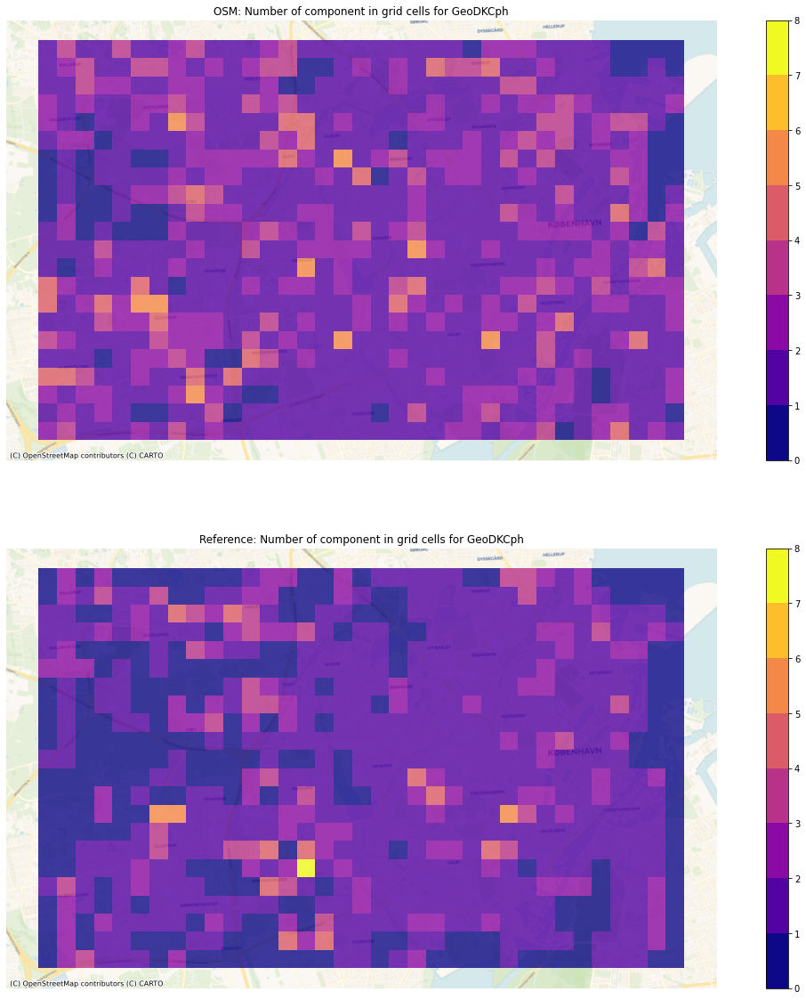

In [146]:
# Plot

# set up figure
fig, ax = plt.subplots(2,1,figsize=(20,20))

# compute number of colors we need and generate normalized colormap
ncolors = max(grid["component_nrs_osm"].max(), grid["component_nrs_ref"].max())
mynorm = colors.Normalize(vmin = 0, vmax = ncolors)
mycm = cm.get_cmap(pdict["seq"], ncolors + 1)

# OSM data set:
i = 0
mycm = cm.get_cmap(pdict["seq"], ncolors)
grid.plot(
    ax = ax[i], 
    column = "component_nrs_osm",
    legend = True, 
    cmap = mycm,
    norm = mynorm,
    alpha = pdict["alpha_grid"])
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('OSM: Number of component in grid cells for ' + study_area)
ax[i].set_axis_off()

# Reference data set:
i = 1
mycm = cm.get_cmap(pdict["seq"], np.unique(grid["component_nrs_ref"]).max())
grid.plot(
    ax = ax[i], 
    column = "component_nrs_ref",
    legend=True,
    cmap = mycm,
    norm = mynorm,
    alpha = pdict["alpha_grid"]
    )
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Reference: Number of component in grid cells for ' + study_area)
ax[i].set_axis_off()

### Component connectivity

Visualising differences between how many cells can be reached from each cell.
Positive values in the plot means that more cells can be reached from this particular cell using the OSM data, while negative values indicate a higher connectivity using the reference data set.

This is a crude measure for network connectivity, but has the benefit of being computationally cheap and thus able to highlight stark differences in network connectivity in very little time.

In [169]:
osm_components_cell_count = ef.count_component_cell_reach(osm_components_df, grid, 'component_ids_osm')
grid['cells_reached_osm'] = grid['component_ids_osm'].apply(lambda x: ef.count_cells_reached(x, osm_components_cell_count) if x != '' else 0)

ref_components_cell_count = ef.count_component_cell_reach(ref_components_df, grid, 'component_ids_ref')
grid['cells_reached_ref'] = grid['component_ids_ref'].apply(lambda x: ef.count_cells_reached(x, ref_components_cell_count) if x != '' else 0)

grid['cells_reached_osm_pct'] = grid.apply(lambda x: np.round((x.cells_reached_osm / len(grid))*100, 2), axis = 1)
grid['cells_reached_ref_pct'] = grid.apply(lambda x: np.round((x.cells_reached_ref / len(grid))*100, 2), axis = 1)
grid['cell_reach_diff_pct'] = grid['cells_reached_osm_pct'] - grid['cells_reached_ref_pct']

# @Ane: to discuss (alternative percentage computation)
# grid['cell_reach_diff_pct_2'] = None
# grid.loc[grid["cells_reached_osm"]>0, "cell_reach_diff_pct_2"] = grid[grid["cells_reached_osm"]>0].apply(lambda x: 
#      np.round( ((x.cells_reached_osm - x.cells_reached_ref) / x.cells_reached_osm)*100, 2) , 
#      axis = 1).min()

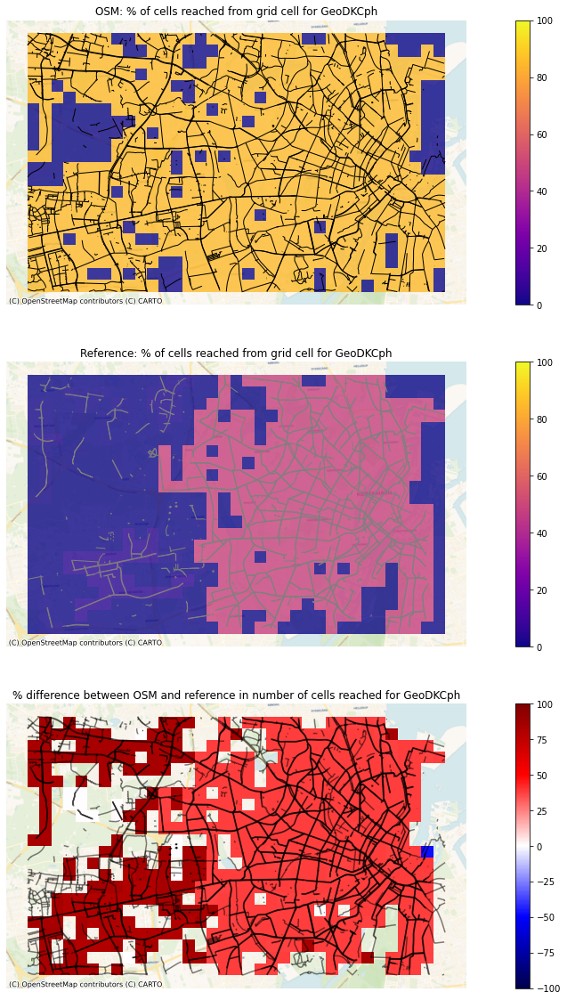

In [171]:
# set up figure
fig, ax = plt.subplots(3,1,figsize=(20,20))

# norm for color bars
cbnorm_reach = colors.Normalize(vmin=0, vmax=100)
cbnorm_reach_diff = colors.Normalize(vmin=-100, vmax=100)

# OSM data set:
i = 0
grid.plot(
    ax = ax[i], 
    column = "cells_reached_osm_pct",
    legend=True, 
    cmap = pdict["seq"],
    norm = cbnorm_reach,
    alpha = pdict["alpha_grid"])
osm_edges_simplified.plot(ax=ax[i], color=pdict["osm_base"], linewidth = 1)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('OSM: % of cells reached from grid cell for ' + study_area)
ax[i].set_axis_off()

# Reference data set:
i = 1
grid.plot(
    ax = ax[i], 
    column = "cells_reached_ref_pct",
    legend=True, 
    cmap = pdict["seq"],
    norm = cbnorm_reach,
    alpha = pdict["alpha_grid"])
ref_edges_simplified.plot(ax=ax[i], color=pdict["ref_base"], linewidth = 1)
cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('Reference: % of cells reached from grid cell for ' + study_area)
ax[i].set_axis_off()

# Difference
i = 2
grid.loc[(grid.cells_reached_osm!= 0) & (grid.cells_reached_ref!=0)].plot(
    ax=ax[i], 
    column='cell_reach_diff_pct', 
    norm=cbnorm_reach_diff, 
    cmap=pdict["diff"], 
    legend=True)

osm_edges_simplified.plot(ax=ax[i], color=pdict["osm_base"], alpha=0.5)
ref_edges_simplified.plot(ax=ax[i], color=pdict["osm_base"], alpha=0.5)

cx.add_basemap(ax = ax[i], crs=study_crs, source=cx.providers.CartoDB.Voyager)
ax[i].set_title('% difference between OSM and reference in number of cells reached for ' + study_area)
ax[i].set_axis_off()

In [ ]:
# Saving results of component analysis

results_osm['component_count'] = len(osm_components)
results_osm['largest_cc_pct_size'] = osm_largest_cc_pct
results_osm['largest_cc_length_km'] = osm_largest_cc_length / 1000
results_osm['component_gaps'] = len(osm_comp_gaps)

results_ref['component_count'] = len(ref_components)
results_ref['largest_cc_pct_size'] = ref_largest_cc_pct
results_ref['largest_cc_length_km'] = ref_largest_cc_length / 1000
results_ref['component_gaps'] = len(ref_comp_gaps)

________________________

## 6. Save results

In [ ]:
all_results['osm_results'] = results_osm
all_results['ref_results'] = results_ref

with open(f'../results/extrinsic_analysis_{study_area}.json', 'w') as outfile:
    json.dump(all_results, outfile)

with open(f'../results/grid_results_extrinsic_{study_area}.pickle', 'wb') as f:
    pickle.dump(grid, f)

_________________

For a summary of core metrics, run the notebook [summary of extrinsic analysis](./03c_extrinsic_analysis_summary.ipynb).